In [2]:
#+++ версия 2020.09.21 инициализация посредством global init()
from importlib import reload
import sys; 
sys.path.append("../../lib/")



from  colorise import * 
from  geo import * 

import adds
adds = reload(adds)
from adds import * # import adds functions

init()


# if 'adds' in sys.modules.keys(): 
#     del sys.modules['adds'];
#     print ("del adds")

# print (sys.modules)

ii(dfr,1)

0:00:00.000 ₀╷₀₀╷₀₀.₀₀₀ init()


,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
0,HTML,Path,Struct,__builtins__,__cached__,__doc__,__file__,__loader__,__name__,__package__,__spec__,_log,_o,adds,clear_output,datetime
1,df_info,dfr,disp,display,draw_l,glob,gmtime,grpp,ii,init,isfile,join,l,listdir,math,merge_OKVED
2,np,os,pd,plt,read_rmsp,reload,requests,shutil,sizeof_fmt,start,strftime,time,tm,tmpxls,xl_rowcol_to_cell,xlspcl
3,zipfile,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-


,name,rows,cols,memory,keys


In [3]:
sys.path.append("../../settings/")

if 'creds' in sys.modules.keys(): del sys.modules['creds'];
import  creds
# print(creds.pg_creds)

In [36]:
del sys.modules['colorise'];

{'speed': {'#993402': 5, '#fe0100': 10, '#fea000': 20, '#fbff00': 30, '#03ff00': 40, '#00b47b': 50, '#04cbd9': 60, '#1c65c9': 80, '#5006da': 100, '#555555': 300}}


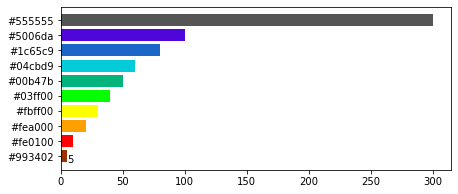

{'speed2': {'#993402': 5, '#FE0100': 10, '#FEA000': 20, '#FED000': 30, '#FBFF00': 40, '#03FF00': 50, '#00B47B': 60, '#04CBD9': 80, '#358AFF': 100, '#DC01FE': 120, '#999999': 300}}


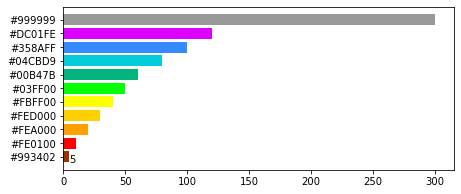

{'parking_price': {'#aaaa': 10, '#cc0202': 20, '#FE5500': 40, '#dd7700': 40, '#BB7700': 50, '#FECA00': 60, '#ccee00': 70, '#03bb00': 80, '#00B499': 100, '#04AAD9': 150, '#256Add': 200, '#7755cc': 380, '#772222': 450}}


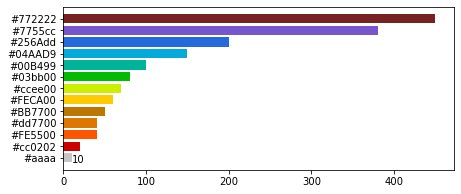

1

In [8]:
colorise_palettes()

In [3]:
import xml.etree.ElementTree as ET
from datetime import datetime

def parse_gpx(f):

    tree = ET.parse(f)

    # print (tree) 

    # for e in tree.iter():
    #     yield e
    #     try:
    #         yield e.text
    #     except:
    #         continue

    prefix_map = {
        "n0": "http://www.topografix.com/GPX/1/1",
        "n1": "http://www.garmin.com/xmlschemas/TrackPointExtension/v1"
    }

    pnts = []

    for e in tree.findall("n0:trk/n0:trkseg/n0:trkpt", prefix_map)[::1]:
        p = {}
        p['lon'] = float(e.attrib['lon'])
        p['lat'] = float(e.attrib['lat'])
        p['unixtime'] = int(e.findall("n0:desc", prefix_map)[0].text[34:44])
        p['datetime'] = datetime.fromtimestamp(p['unixtime']).strftime("%Y-%m-%d %H:%M:%S")
        p['speed'] = float(e.findall("n0:extensions/n1:TrackPointExtension/n1:speed", prefix_map)[0].text)
    #     absoluteTime
    #     p['time'] = datetime.fromtimestamp(1651931066).strftime("%Y-%m-%d %H:%M:%S")
        pnts = pnts + [p] 


    dfr['track1'] = pd.DataFrame(pnts)   

    
f = 'data/Zepp20220508064546.gpx'  


parse_gpx(f)    
    
dfr['track1'].shape[0]

1304

{'speed': {'#993402': 5, '#fe0100': 10, '#fea000': 20, '#fbff00': 30, '#03ff00': 40, '#00b47b': 50, '#04cbd9': 60, '#1c65c9': 80, '#5006da': 100, '#555555': 300}}


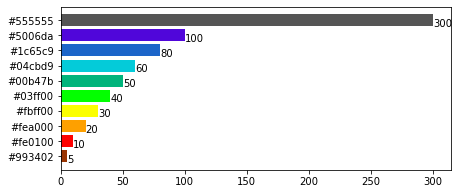

{'scooter': {'#bb2202': 2, '#FE0100': 5, '#FEA000': 10, '#FED000': 15, '#FBFF00': 20, '#03FF00': 25, '#00B47B': 30, '#04CBD9': 35, '#358AFF': 40, '#DC01FE': 45, '#999999': 60}}


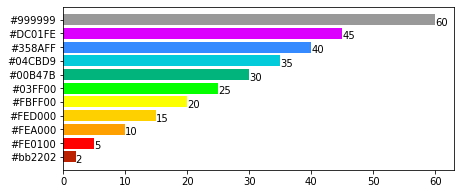

{'parking_price': {'#aaaa': 10, '#cc0202': 20, '#FE5500': 40, '#dd7700': 40, '#BB7700': 50, '#FECA00': 60, '#ccee00': 70, '#03bb00': 80, '#00B499': 100, '#04AAD9': 150, '#256Add': 200, '#7755cc': 380, '#772222': 450}}


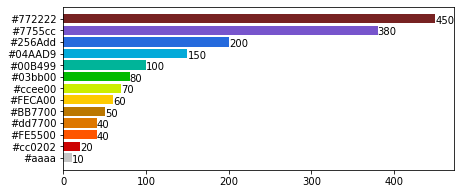

In [35]:
palettes  = {
    "speed":{'#993402': 5,
     '#fe0100': 10,
     '#fea000': 20,
     '#fbff00': 30,
     '#03ff00': 40,
     '#00b47b': 50,
     '#04cbd9': 60,
     '#1c65c9': 80,
     '#5006da': 100,
     '#555555': 300
    },
    
    "scooter":{'#bb2202':2,
     '#FE0100':5,
     '#FEA000':10,
     '#FED000':15,
     '#FBFF00':20,
     '#03FF00':25,
     '#00B47B':30,
     '#04CBD9':35,
     '#358AFF':40,
     '#DC01FE':45,
     '#999999':60
    },
    
    "parking_price":
    {'#aaaa': 10,
        '#cc0202':  20,
        '#FE5500':  40,
        '#dd7700':  40,
        '#BB7700':  50,
        '#FECA00':  60,
        '#ccee00':  70,
        '#03bb00':  80,
        '#00B499': 100,
        '#04AAD9': 150,
        '#256Add': 200,
        '#7755cc': 380,
        '#772222': 450
    }
}




def colorise(x, palette = palettes['parking_price']):
    
    
    return [i[1:] for i in palette if float(palette[i]) >= float(x) ][0]


def colorise_palettes():
    import matplotlib.pyplot as plt
    
    for k in palettes:
        fig, ax = plt.subplots(figsize=(7, 3))
        print ({k:palettes[k]})
        x,y = list(palettes[k].keys()),list(palettes[k].values())
        barlist = ax.barh(x, y, color = x )
        for i,b in enumerate(barlist):
#             print(y[i],b.xy[1],y[i])
            ax.text(y[i],b.xy[1],y[i])
        plt.show()

            
            
colorise(10)
colorise_palettes()

In [4]:

colors = [c for c in sns.color_palette("Paired").as_hex()]

dict(zip(colors,range(1,len(colors))))



{'#a6cee3': 1,
 '#1f78b4': 2,
 '#b2df8a': 3,
 '#33a02c': 4,
 '#fb9a99': 5,
 '#e31a1c': 6,
 '#fdbf6f': 7,
 '#ff7f00': 8,
 '#cab2d6': 9,
 '#6a3d9a': 10,
 '#ffff99': 11}

In [286]:
print(palettes)

{'speed': {'#993402': 5, '#fe0100': 10, '#fea000': 20, '#fbff00': 30, '#03ff00': 40, '#00b47b': 50, '#04cbd9': 60, '#1c65c9': 80, '#5006da': 100, '#555555': 300}, 'scooter': {'#bb2202': 2, '#FE0100': 5, '#FEA000': 10, '#FED000': 15, '#FBFF00': 20, '#03FF00': 25, '#00B47B': 30, '#04CBD9': 35, '#358AFF': 40, '#DC01FE': 45, '#999999': 60}, 'parking_price': {'#aaaa': 10, '#cc0202': 20, '#FE5500': 40, '#dd7700': 40, '#BB7700': 50, '#FECA00': 60, '#ccee00': 70, '#03bb00': 80, '#00B499': 100, '#04AAD9': 150, '#256Add': 200, '#7755cc': 380, '#772222': 450}, 'Paired': {'#a6cee3': 1, '#1f78b4': 2, '#b2df8a': 3, '#33a02c': 4, '#fb9a99': 5, '#e31a1c': 6, '#fdbf6f': 7, '#ff7f00': 8, '#cab2d6': 9, '#6a3d9a': 10, '#ffff99': 11}}


In [ ]:
hls_colors =  [c for c in sns.hls_palette(20, l=0.4, s=0.9).as_hex()]
sns.hls_palette(20, l=0.4, s=0.9)

In [14]:
import contextily as ctx
fig, ax = plt.subplots()
gdf.to_crs(epsg=3857).plot(ax=ax, color='red', edgecolor='white')
ctx.add_basemap(ax, url=ctx.providers.CartoDB.Positron) 
plt.title('Car Share', fontsize=30, fontname='Palatino Linotype', color='grey')
ax.axis('off')
plt.show()

ModuleNotFoundError: No module named 'contextily'

In [ ]:
'iVBORw0KGgoAAAANSUhEUgAAAbAAAAEgCAYAAADVKCZpAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjMuMiwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy8vihELAAAACXBIWXMAAAsTAAALEwEAmpwYAAAiGklEQVR4nO3deVjVZf7/8eetgooiLrgr4r4BpuLWpu1qtqg1bdNe1kyzfmcSKk0brWybarLya42VMy0zCZplVjZWWmallYdFUcQNN0QUlB3O/f0DfnP5M0xUOJ/zOef1uC6vPJ6P+r4Dz5ODxzfGWouIiIjbNHB6ABERkdOhgImIiCspYCIi4koKmIiIuJICJiIirqSAiYiIKylgIiLiSgqYiIi4kgImIiKupICJiIgrKWAiIuJKCpiIiLiSAiYiIq6kgImIiCspYCIi4koKmIiIuJICJiIirqSAiYiIKylgIiLiSgqYiIi4kgImIiKupICJiIgrKWAiIuJKCpiIiLiSAiYiIq6kgImIiCspYCIi4koKmIiIuJICJiIirqSAiYiIKylgIiLiSgqYiIi4kgImIiKupICJiIgrNXJ6gPoSGRlpo6OjnR5DRMRV1q9fn2utbev0HLURsAGLjo5m3bp1To8hIuIqxpgdTs9QW/oUooiIuJICJiIirqSAiYiIKzkeMGNMV2PMZ8aYjcaYNGPM72u4xhhj/maMyTTGeIwxQ5yYVURE/Ic/vIijAviTtfZ7Y0w4sN4Ys8Jam37MNeOA3tXfRgAvV/9XRESClOPPwKy1e62131d//wiwEeh83GVXAQttlbVAS2NMRx+PKiIifsTxgB3LGBMNDAa+Oe6uzsCuY25n89PIiYgENa/XsviHbEorKp0exSf84VOIABhjmgNJwB+stQXH313DT7E1/BpTgCkAUVFRdT6jiIi/2pZbSGKSh2+25VFa7uX64YH/GOgXATPGhFAVrzettck1XJINdD3mdhdgz/EXWWvnA/MB4uPjfxI4EZFAU1HpZcFX23jmk82ENmzAnEmxXDes68l/YgBwPGDGGAP8Hdhorf3rCS5bCvzGGPMOVS/eyLfW7vXVjCIi/mjj3gISkjx4svO5uH97Zl8dQ4eIJk6P5TOOBww4B7gZSDHG/Fj9Yw8CUQDW2nnAh8B4IBMoAm73/ZgiIv6htKKSFz/bykufZRLRNIQXbhjMhLiOVD0fCB6OB8xa+yU1/x3XsddY4D7fTCQi4r++33mIhEUetuQcZeLgzkyfMIDWzUKdHssRjgdMREROrqisgmc+2cyCr7bRoUUTXrttGBf0a+f0WI5SwERE/NxXmbkkJnvYlVfML0dGkTC2H+FNQpwey3EKmIiIn8ovLuexZRv517pddI9sxr+mjGREjzZOj+U3FDARET/0Sdo+pi1JJfdoKfeM7sEfL+5Dk5CGTo/lVxQwERE/cuBIKTPfT2OZZy/9OoTz6q3xxHVp6fRYfkkBExHxA9Zalvy4m0feT6eotJI/X9qHe0b3JKShX2388ysKmIiIw3YfLuahxSl8nnGAIVEtefKaOHq1C3d6LL+ngImIOMTrtbz5zQ7mLN+E18KMKwZwy6hoGjYIrn+QfLoUMBERB2QdOEpiUgrfbs/j3F6RPD4plq6tw5wey1UUMBERH6qo9PLK6m08++lmmjRqwJPXxHHt0C5BtwaqLihgIiI+kr6ngKlJG0jdXcBlA9sz66oY2rUInuW7dU0BExGpZyXllcxdmcm8L7bSMiyUl28awrhYfVH5M6WAiYjUo/U78pi6yMPWA4VMHtKF6RP60zIsOJfv1jUFTESkHhSWVvDUxxm88fV2OkU05Y07hjO6T1unxwooCpiISB1btfkADySnsPtwMbeO6sb9Y/vRvLEebuua/o+KiNSR/KJyZi1LZ9H6bHq0bca7945iWHRrp8cKWAqYiEgd+Ch1L9PfSyOvsIxfj+nJ7y7qreW79UwBExE5AzlHSpjxXhrLU/cxoGMLXrttGDGdI5weKygoYCIip8Fay6L12cxetpHi8kruv6wvU87voeW7PqSAiYicol15RTy4OIXVW3KJ79aKOZPj6NWuudNjBR0FTESklrxey8Kvt/PkxxkAPHLlQG4e2Y0GWr7rCAVMRKQWMnOOkpjkYd2OQ5zfpy2PTYyhSyst33WSAiYi8jPKK73MX5XF859uoWloQ565dhCThnTW8l0/oICJiJxA6u58pi7ykL63gPGxHXjkyhjahjd2eiyppoCJiBynpLyS5/+zhfmrsmjdLJR5vxzC2Bgt3/U3CpiIyDG+255HwiIPWbmFXDu0C9MuH0BEWIjTY0kNFDAREeBoaQVPfrSJhV/voEurpvzjzuGc11vLd/2ZAiYiQe/zjBweWpzKnvxibj8nmj9f2pdmWr7r9/QWEpGgdaiwjFnL0kn+fje92jVn0b1nM7RbK6fHklpSwEQk6Fhr+TBlHzOWpnK4qJzfXtiL31zYi8aNtHzXTRQwEQkqOQUlTFuSyifp+4ntHMHCO0YwoFMLp8eS0+B4wIwxC4AJQI61NqaG+yOAfwJRVM37tLX2Nd9OKSJuZ63l3XXZzFqWTlmFl8Rx/bjr3O400vJd13I8YMDrwFxg4Qnuvw9It9ZeYYxpC2QYY9601pb5akARcbddeUU8kJzCl5m5DO/emjmTYunRVst33c7xgFlrVxljon/uEiDcVO1taQ7kARW+mE1E3K3Sa3ljzXae+jiDhg0Ms6+O4cbhUVq+GyAcD1gtzAWWAnuAcOA6a63X2ZFExN9t2X+EqUkefth5mDF92/LYxFg6tWzq9FhSh9wQsMuAH4ELgZ7ACmPMamttwfEXGmOmAFMAoqKifDmjiPiJsgov877YytyVmTRr3JDnrjuLq87qpOW7AcgNAbsdmGOttUCmMWYb0A/49vgLrbXzgfkA8fHx1qdTiojjPNmHmbrIw6Z9R5gQ15GZVw4ksrmW7wYqNwRsJ3ARsNoY0x7oC2Q5O5KI+JOS8kqeXbGZV1ZnEdm8MfNvHsqlAzs4PZbUM8cDZox5GxgDRBpjsoEZQAiAtXYeMAt43RiTAhggwVqb69C4IuJn1mYdJDHJw/aDRdwwvCuJ4/oT0VTLd4OB4wGz1t5wkvv3AJf6aBwRcYkjJeXMWb6JN7/ZSVTrMN66awRn94p0eizxIccDJiJyqlZu2s9Di1PZX1DCXed2538u7UNYqB7Ogo3e4iLiGnmFZfzl/TSW/LiH3u2a89KvzmZwlJbvBisFTET8nrWW9z17mbk0jYLicn5/UW9+fUFPLd8NcgqYiPi1fflVy3c/3bifQV0ieOLuEfTroOW7ooCJiJ+y1vLOd7t4bNlGyr1eHhrfnzvO7U5DrYGSagqYiPidHQcLSUxK4eusg4zs0Zo5k+KIjmzm9FjiZxQwEfEblV7La19t4+lPMghp0IDHJsZy/bCuWr4rNVLARMQvZOyrWr67YddhLurXjtkTY+gYoeW7cmIKmIg4qqzCy0ufZ/LiZ5mENwnh+evP4spBWr4rJ6eAiYhjftx1mIRFHjL2H+Gqszrx8IQBtNHyXaklBUxEfK64rJK/rsjg719uo114E/5+azwX9W/v9FjiMgqYiPjUmq25JCalsDOviBtHRJE4rh8tmmj5rpw6BUxEfKKgpJzHP9zE29/upFubMN6+eySjerZxeixxMQVMROrdp+n7eWhJCgeOlDLl/B788eI+NA3VGig5MwqYiNSbg0dLmfl+Ou9v2EO/DuHMvzmeQV1bOj2WBAgFTETqnLWWpRv2MHNpGkdLK/ifS/pw7+iehDZq4PRoEkAUMBGpU3sOFzNtSSorN+VwVteWPHlNHH3ahzs9lgQgBUxE6oTXa3nr253MWb6JSq9l+oQB3HZ2tJbvSr1RwETkjG3LLSQxycM32/I4p1cbHp8YR1SbMKfHkgCngInIaauo9PL3L7fx1xWbCW3UgCcmx/KL+K5aAyU+oYCJyGnZuLeAhCQPnux8LhnQntlXx9C+RROnx5IgooCJyCkprajkxZWZvPT5VlqGhfDijUMYH9tBz7rE5xQwEam173ceImGRhy05R5k0uDPTJwygVbNQp8eSIKWAichJFZVV8PTHm3ltzTY6tmjCa7cP44K+7ZweS4KcAiYiP+vLLbkkJnvIPlTMzSO7MXVsX8K1fFf8gAImIjXKLy7n0WXp/HtdNt0jm/GvKSMZ0UPLd8V/KGAi8hMfp+1j+pJUDhaWce/onvzh4t40CdHyXfEvCpiI/NeBI6XMXJrGspS99O/Ygr/fOozYLhFOjyVSIwVMRLDWsviH3fzlg3SKSiu5/7K+TDm/ByENtXxX/JcCJhLkdh8u5sHkFL7YfIAhUVXLd3u10/Jd8X8KmEiQ8not//xmB08s34QFZl4xgJtHafmuuIfjATPGLAAmADnW2pgTXDMGeA4IAXKttaN9NZ9IINp64CiJSR6+236I83pH8tjEWLq21vJdcRfHAwa8DswFFtZ0pzGmJfASMNZau9MYo389KXKaKiq9zF+dxXOfbqFJowY8dU0c1wztojVQ4kqOB8xau8oYE/0zl9wIJFtrd1Zfn+OTwUQCTNqefBKSPKTuLmDswA785eqBtAvX8l1xL8cDVgt9gBBjzOdAOPC8tbbGZ2si8lMl5ZW8sHIL877IolVYKC/fNIRxsR2dHkvkjLkhYI2AocBFQFPga2PMWmvt5uMvNMZMAaYAREVF+XRIEX+0bnseCUketh4oZPKQLkyf0J+WYVq+K4HBDQHLpuqFG4VAoTFmFTAI+EnArLXzgfkA8fHx1qdTiviRwtIKnvo4gze+3k6niKa8ccdwRvdp6/RYInXKDQF7D5hrjGkEhAIjgGedHUnEf63afIAHklPYk1/MraOi+fNlfWne2A1/1EVOjePv1caYt4ExQKQxJhuYQdXL5bHWzrPWbjTGfAR4AC/wqrU21al5RfzV4aIyZi/byKL12fRo24x37xlFfHRrp8cSqTeOB8xae0MtrnkKeMoH44i40vKUvUx/L41DRWXcd0FPfnuhlu9K4HM8YCJy+nKOlDDjvTSWp+5jYKcWvHHHMAZ20vJdCQ4KmIgLWWtZtD6bWR+kU1LhZerYvtx9npbvSnBRwERcZldeEQ8uTmH1llyGRbdizuQ4erZt7vRYIj6ngIm4hNdrWfj1dp78OAMDzLpqIDeN6EYDLd+VIKWAibhAZs4REpJSWL/jEKP7tOXRiTF0aaXluxLcFDARP1Ze6WX+qiye/3QLYY0b8tdfDGLi4M5aviuCAibit1J353P/Ig8b9xZweWxHZl45kLbhjZ0eS8RvKGAifqakvJLnPt3CK6uzaN0slHm/HMrYmA5OjyXidxQwET/y7bY8EpM8ZOUWcl18Vx4c35+IsBCnxxLxSwqYiB84WlrBE8s38Y+1O+jSqin/vHME5/aOdHosEb+mgIk47LOMHB5KTmFvQQl3nNOdP1/Wh7BQ/dEUORn9KRFxyKHCMmZ9kE7yD7vp1a45i+49m6HdWjk9lohrKGAiPmat5cOUfcxYmsrhonJ+d2Ev7ruwF40bafmuyKlQwER8aH9BCdOXpPJJ+n5iO0fwjztH0L9jC6fHEnElBUzEB6y1/HvdLmYv20hZhZcHxvXjznO700jLd0VOmwImUs92HizigcUevso8yPDurXlichzdI5s5PZaI6ylgIvWk0mt5fc12nv44g4YNDLOvjuHG4VFavitSRxQwkXqwZf8RpiZ5+GHnYS7o25ZHJ8bSqWVTp8cSCSgKmEgdKqvwMu+LrbywcgvNGzfiuevO4qqzOmn5rkg9UMBE6siGXYdJSPKwad8RrhjUiRlXDCCyuZbvitQXBUzkDBWXVfLcp5t5ZXUWbcMb88ot8VwyoL3TY4kEPAVM5AyszTpIYpKH7QeLuGF4Vx4Y358WTbR8V8QXFDCR03CkpJw5yzfx5jc7iWodxlt3jeDsXlq+K+JLCpjIKVq5aT8PLU5lf0EJd53bnT9d2pemoVoDJeJrCphILR08WspfPkjnvR/30Kd9c1666WwGR2n5rohTFDCRk7DW8r5nLzOXpnGkpJw/XNybX4/pRWgjrYEScZICJvIz9uWXMG1JCp9uzGFQ15Y8OTmOvh3CnR5LRFDARGpkreWd73bx2LKNlHu9TLu8P7ef052GWgMl4jcUMJHj7DhYSGJSCl9nHWRUjzbMmRxLtzZavivibxQwkWqVXsuCL7fxzIoMQho04PFJsVw/rKvWQIn4KccDZoxZAEwAcqy1MT9z3TBgLXCdtXaRr+aT4JCx7whTF21gQ3Y+F/dvx+yrY+kQ0cTpsUTkZzgeMOB1YC6w8EQXGGMaAk8AH/toJgkSZRVeXvwsk5c+z6RFkxBeuGEwE+I66lmXiAs4HjBr7SpjTPRJLvstkAQMq/+JJFj8uOswUxdtYPP+o1x9VicevmIgrZuFOj2WiNSS4wE7GWNMZ2AicCEKmNSB4rJKnvkkgwVfbaN9iyYsuC2eC/tp+a6I2/h9wIDngARrbeXJPq1jjJkCTAGIioqq/8nEddZszSUxKYWdeUXcNCKKxHH9CNfyXRFXckPA4oF3quMVCYw3xlRYa5ccf6G1dj4wHyA+Pt76ckjxb/nF5cxZvpG3v91FdJsw3pkykpE92jg9loicAb8PmLW2+//7vjHmdeCDmuIlciIr0vczbUkKB46Ucs/5PfjDxX20fFckADgeMGPM28AYINIYkw3MAEIArLXzHBxNXC73aCkzl6bxgWcv/TqE88ot8cR1aen0WCJSRxwPmLX2hlO49rZ6HEUChLWW937cwyPvp1FYWsmfLunDPaN7avmuSIBxPGAidWnP4WKmLUll5aYcBkdVLd/t3V7Ld0UCkQImAcHrtbz17U7mLN9Epdfy8IQB3Hp2tJbvigQwBUxcb1tuIQlJHr7dlse5vSJ5fFIsXVuHOT2WiNQzBUxcq6LSy6tfbuPZFZsJbdSAJyfHcW18F62BEgkSCpi4UvqeAhKSPKTszufSAe2ZdXUM7Vto+a5IMFHAxFVKKyqZuzKTlz/fSsuwEF68cQjjYzvoWZdIEFLAxDXW7zhEQpKHzJyjTBrSmemXD6CVlu+KBC0FTPxeYWkFT3+SwetrttOxRRNeu30YF/Rt5/RYIuIwBUz82uotB3ggOYXsQ8XcMqobU8f2o3ljvduKiAImfiq/qJxHP0zn3+uy6RHZjH/fM4rh3Vs7PZaI+BEFTPzOR6n7mP5eKnmFZfxqTE9+f1FvmoRo+a6I/P8UMPEbB45ULd9dlrKXAR1b8Nptw4jpHOH0WCLipxQwcZy1luTvd/OXD9IpLqvk/sv6MuX8HoQ01PJdETkxBUwclX2oiIcWp/LF5gMM7daKJybH0atdc6fHEhEXUMDEEV6v5Z/f7OCJ5ZuwwCNXDuTmkd1ooOW7IlJLCpj43NYDR0lM8vDd9kOc1zuSxyZq+a6InDoFTHymvNLLK6uzeO7TLTQNacjT1w5i8pDOWgMlIqdFAROfSN2dT0KSh7Q9BYyL6cAjVw2kXbiW74rI6VPApF6VlFfywsotzPsii1Zhobx80xDGxXZ0eiwRCQAKmNSbddvzmJrkIetAIdcO7cJDl/enZZiW74pI3VDApM4dLa3gqY82sXDtDjpFNGXhHcM5v09bp8cSkQCjgEmd+mLzAR5MTmFPfjG3jorm/sv60kzLd0WkHuiRRerE4aIyZn2wkaTvs+nZthnv3jOK+Ggt3xWR+qOAyRlbnrKX6e+lcaiojN9c0IvfXNhLy3dFpN4pYHLacgpKePi9ND5K28fATi14445hDOyk5bsi4hsKmJwyay3vrs9m9gfplFR4SRjbj7vP604jLd8VER9SwOSU7Mor4sHFKazeksvw6NbMmRxLj7ZavisivqeASa1Uei0Lv97OUx9nYIBZVw3kphFavisizlHA5KQyc46QkJTC+h2HGN2nLY9NiqVzy6ZOjyUiQU4BkxMqr/Tyv19s5W//ySSscUP++otBTBys5bsi4h8UMKlRSnY+U5M8bNxbwOVxHZl5xUDahjd2eiwRkf9yPGDGmAXABCDHWhtTw/03AQnVN48Cv7LWbvDhiEGlpLyS5z7dwiurs2jTLJT/vXkolw3s4PRYIiI/4XjAgNeBucDCE9y/DRhtrT1kjBkHzAdG+Gi2oPJN1kESk1PYllvIdfFdefDy/kQ0DXF6LBGRGjkeMGvtKmNM9M/cv+aYm2uBLvU+VJA5UlLOkx9l8I+1O+jauilv3jWCc3pFOj2WiMjPcjxgp+hOYLnTQwSSzzJyeCg5hb0FJdxxTnf+fFkfwkLd9m4hIsHINY9UxpgLqArYuT9zzRRgCkBUVJSPJnOnQ4VlzPogneQfdtO7XXOSfnU2Q6JaOT2WiEituSJgxpg44FVgnLX24Imus9bOp+rvyIiPj7c+Gs9VrLUsS9nLjPfSyC8u53cX9ea+C3rSuJGW74qIu/h9wIwxUUAycLO1drPT87jZ/oISpi1JZUX6fuK6RPDPu0bQv2MLp8cSETktjgfMGPM2MAaINMZkAzOAEABr7TzgYaAN8FL1P6CtsNbGOzOtO1lr+fe6XcxetpGyCi8Pju/HHedo+a6IuJvjAbPW3nCS++8C7vLROAFn58EiEpM9rNl6kBHdW/PE5DiiI5s5PZaIyBlzPGBSPyq9ltfXbOfpjzNo2MDw6MQYbhgWpeW7IhIwFLAAtHn/EaYu8vDjrsNc2K8dj06MoWOElu+KSGBRwAJIWYWXlz/fytzPthDeJITnrz+LKwd10vJdEQlICliA2LDrMAlJHjbtO8KVgzox44oBtGmu5bsiErgUMJcrLqvk2U838+rqLNqFN+HVW+K5eEB7p8cSEal3CpiLfb31IA8ke9h+sIgbhkfxwPh+tGii5bsiEhwUMBcqKClnzvJNvPXNTrq1CeOtu0dwdk8t3xWR4KKAucx/Nu7nocWp5Bwp4e7zuvM/l/SlaajWQIlI8FHAXOLg0VIeeT+dpRv20Ld9OPNuHspZXVs6PZaIiGMUMD9nrWXphj088n46R0rK+ePFffjVmJ6ENtIaKBEJbgqYH9ubX8y0xan8Z1MOg7q25MnJcfTtEO70WCIifkEB80Ner+Wd73bx+IcbKfd6mXZ5f24/pzsNtQZKROS/FDA/sz23kMRkD2uz8ji7ZxsenxRLtzZavisicjwFzE9UVHp57avtPLMig5AGDZgzKZbrhnXVGigRkRNQwPzApn0FJCzysCE7n4v7t2f21TF0iGji9FgiIn5NAXNQaUUlL362lZc+yySiaQgv3DCYCXEd9axLRKQWFDCH/LDzEAlJHjbvP8rEwZ2ZPmEArZuFOj2WiIhrKGA+VlRWwTOfbGbBV9vo0KIJC26L58J+Wr4rInKqFDAfWpOZS2JyCjvzivjlyCgSxvYjXMt3RUROiwLmA/nF5Tz+4Ube+W4X3SOb8a8pIxnRo43TY4mIuJoCVs8+SdvHtCWp5B4t5Z7RPfjjxX1oEqLluyIiZ0oBqye5R0uZuTSNDzx76dchnFdvjSeuS0unxxIRCRgKWB2z1rLkx9088n46RaWV/OmSPtw7pichDbV8V0SkLilgdWjP4WIeWpzCZxkHGBxVtXy3d3st3xURqQ8KWB3wei1vfruTJ5ZvotJrmXHFAG4ZFa3luyIi9UgBO0NZB46SmJTCt9vzOLdXJI9PiqVr6zCnxxIRCXgK2GmqqPTy6pfbeHbFZho3asCT18Rx7dAuWgMlIuIjCthpSN9TwNSkDaTuLuCyge2ZdVUM7Vpo+a6IiC8pYKegtKKSuSszefnzrbQMC+Glm4YwLqaDnnWJiDhAAaul9Tuqlu9m5hxl8pAuTLu8P620fFdExDGOB8wYswCYAORYa2NquN8AzwPjgSLgNmvt976ar7C0gqc/yeD1NdvpFNGUN+4Yzug+bX3124uIyAk4HjDgdWAusPAE948Deld/GwG8XP3ferd6ywEeSE4h+1Axt47qxv1j+9G8sT/8LxMREccfja21q4wx0T9zyVXAQmutBdYaY1oaYzpaa/fW10z5ReXMXpbOu+uz6dG2Ge/eO4ph0a3r67cTEZHT4HjAaqEzsOuY29nVP1YvAVuRvp8HF6eQV1jGr8f05HcX9dbyXRERP+SGgNX0Ej9b44XGTAGmAERFRZ3Wb5Z9qIi2zRvz2m3DiOkccVq/hoiI1D83BCwb6HrM7S7AnpoutNbOB+YDxMfH1xi5k7llVDS/HNlNy3dFRPycGx6llwK3mCojgfz6/Puvhg2M4iUi4gKOPwMzxrwNjAEijTHZwAwgBMBaOw/4kKqX0GdS9TL6252ZVERE/InjAbPW3nCS+y1wn4/GERERl9DnykRExJUUMBERcSUFTEREXEkBExERV1LARETElUzVi/wCjzHmALDjNH96JJBbh+O4gc4cHHTm4HAmZ+5mrXXFl9wI2ICdCWPMOmttvNNz+JLOHBx05uAQLGfWpxBFRMSVFDAREXElBaxm850ewAE6c3DQmYNDUJxZfwcmIiKupGdgIiLiSkEdMGPMWGNMhjEm0xiTWMP9xhjzt+r7PcaYIU7MWZdqceabqs/qMcasMcYMcmLOunSyMx9z3TBjTKUx5hpfzlfXanNeY8wYY8yPxpg0Y8wXvp6xrtXi/TrCGPO+MWZD9Zld/1UtjDELjDE5xpjUE9wfcI9fP2GtDcpvQENgK9ADCAU2AAOOu2Y8sJyqrwo9EvjG6bl9cOazgVbV3x8XDGc+5rqVVH35nmucnrue38YtgXQgqvp2O6fn9sGZHwSeqP5+WyAPCHV69jM89/nAECD1BPcH1ONXTd+C+RnYcCDTWptlrS0D3gGuOu6aq4CFtspaoKUxpqOvB61DJz2ztXaNtfZQ9c21VH0FbDerzdsZ4LdAEpDjy+HqQW3OeyOQbK3dCWCtDYYzWyDcGGOA5lQFrMK3Y9Yta+0qqs5xIoH2+PUTwRywzsCuY25nV//YqV7jJqd6njup+gjOzU56ZmNMZ2AiMM+Hc9WX2ryN+wCtjDGfG2PWG2Nu8dl09aM2Z54L9Af2ACnA7621Xt+M55hAe/z6Cce/oKWDTA0/dvxLMmtzjZvU+jzGmAuoCti59TpR/avNmZ8DEqy1lVUfoLtabc7bCBgKXAQ0Bb42xqy11m6u7+HqSW3OfBnwI3Ah0BNYYYxZba0tqOfZnBRoj18/EcwBywa6HnO7C1UfnZ3qNW5Sq/MYY+KAV4Fx1tqDPpqtvtTmzPHAO9XxigTGG2MqrLVLfDJh3art+3WutbYQKDTGrAIGAW4NWG3OfDswx1b95VCmMWYb0A/41jcjOiLQHr9+Ipg/hfgd0NsY090YEwpcDyw97pqlwC3Vr+YZCeRba/f6etA6dNIzG2OigGTgZhd/RH6sk57ZWtvdWhttrY0GFgG/dmm8oHbv1+8B5xljGhljwoARwEYfz1mXanPmnVQ948QY0x7oC2T5dErfC7THr58I2mdg1toKY8xvgI+pehXTAmttmjHm3ur751H1irTxQCZQRNVHca5VyzM/DLQBXqp+RlJhXbwUtJZnDhi1Oa+1dqMx5iPAA3iBV621Nb4U2w1q+TaeBbxujEmh6lNrCdZaV2+oN8a8DYwBIo0x2cAMIAQC8/GrJtrEISIirhTMn0IUEREXU8BERMSVFDAREXElBUxERFxJARMREVdSwERExJUUMBERcSUFTEREXEkBExERV1LARETElRQwERFxJQVMRERcSQETERFXUsBERMSVFDAREXElBUxERFxJARMREVdSwERExJUUMBERcSUFTEREXOn/AD0WOu4U5aYyAAAAAElFTkSuQmCC'
'iVBORw0KGgoAAAANSUhEUgAAAbAAAAEgCAYAAADVKCZpAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjMuMiwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy8vihELAAAACXBIWXMAAAsTAAALEwEAmpwYAAAiGklEQVR4nO3deVjVZf7/8eetgooiLrgr4r4BpuLWpu1qtqg1bdNe1kyzfmcSKk0brWybarLya42VMy0zCZplVjZWWmallYdFUcQNN0QUlB3O/f0DfnP5M0xUOJ/zOef1uC6vPJ6P+r4Dz5ODxzfGWouIiIjbNHB6ABERkdOhgImIiCspYCIi4koKmIiIuJICJiIirqSAiYiIKylgIiLiSgqYiIi4kgImIiKupICJiIgrKWAiIuJKCpiIiLiSAiYiIq6kgImIiCspYCIi4koKmIiIuJICJiIirqSAiYiIKylgIiLiSgqYiIi4kgImIiKupICJiIgrKWAiIuJKCpiIiLiSAiYiIq6kgImIiCspYCIi4koKmIiIuJICJiIirqSAiYiIKylgIiLiSgqYiIi4kgImIiKupICJiIgrNXJ6gPoSGRlpo6OjnR5DRMRV1q9fn2utbev0HLURsAGLjo5m3bp1To8hIuIqxpgdTs9QW/oUooiIuJICJiIirqSAiYiIKzkeMGNMV2PMZ8aYjcaYNGPM72u4xhhj/maMyTTGeIwxQ5yYVURE/Ic/vIijAviTtfZ7Y0w4sN4Ys8Jam37MNeOA3tXfRgAvV/9XRESClOPPwKy1e62131d//wiwEeh83GVXAQttlbVAS2NMRx+PKiIifsTxgB3LGBMNDAa+Oe6uzsCuY25n89PIiYgENa/XsviHbEorKp0exSf84VOIABhjmgNJwB+stQXH313DT7E1/BpTgCkAUVFRdT6jiIi/2pZbSGKSh2+25VFa7uX64YH/GOgXATPGhFAVrzettck1XJINdD3mdhdgz/EXWWvnA/MB4uPjfxI4EZFAU1HpZcFX23jmk82ENmzAnEmxXDes68l/YgBwPGDGGAP8Hdhorf3rCS5bCvzGGPMOVS/eyLfW7vXVjCIi/mjj3gISkjx4svO5uH97Zl8dQ4eIJk6P5TOOBww4B7gZSDHG/Fj9Yw8CUQDW2nnAh8B4IBMoAm73/ZgiIv6htKKSFz/bykufZRLRNIQXbhjMhLiOVD0fCB6OB8xa+yU1/x3XsddY4D7fTCQi4r++33mIhEUetuQcZeLgzkyfMIDWzUKdHssRjgdMREROrqisgmc+2cyCr7bRoUUTXrttGBf0a+f0WI5SwERE/NxXmbkkJnvYlVfML0dGkTC2H+FNQpwey3EKmIiIn8ovLuexZRv517pddI9sxr+mjGREjzZOj+U3FDARET/0Sdo+pi1JJfdoKfeM7sEfL+5Dk5CGTo/lVxQwERE/cuBIKTPfT2OZZy/9OoTz6q3xxHVp6fRYfkkBExHxA9Zalvy4m0feT6eotJI/X9qHe0b3JKShX2388ysKmIiIw3YfLuahxSl8nnGAIVEtefKaOHq1C3d6LL+ngImIOMTrtbz5zQ7mLN+E18KMKwZwy6hoGjYIrn+QfLoUMBERB2QdOEpiUgrfbs/j3F6RPD4plq6tw5wey1UUMBERH6qo9PLK6m08++lmmjRqwJPXxHHt0C5BtwaqLihgIiI+kr6ngKlJG0jdXcBlA9sz66oY2rUInuW7dU0BExGpZyXllcxdmcm8L7bSMiyUl28awrhYfVH5M6WAiYjUo/U78pi6yMPWA4VMHtKF6RP60zIsOJfv1jUFTESkHhSWVvDUxxm88fV2OkU05Y07hjO6T1unxwooCpiISB1btfkADySnsPtwMbeO6sb9Y/vRvLEebuua/o+KiNSR/KJyZi1LZ9H6bHq0bca7945iWHRrp8cKWAqYiEgd+Ch1L9PfSyOvsIxfj+nJ7y7qreW79UwBExE5AzlHSpjxXhrLU/cxoGMLXrttGDGdI5weKygoYCIip8Fay6L12cxetpHi8kruv6wvU87voeW7PqSAiYicol15RTy4OIXVW3KJ79aKOZPj6NWuudNjBR0FTESklrxey8Kvt/PkxxkAPHLlQG4e2Y0GWr7rCAVMRKQWMnOOkpjkYd2OQ5zfpy2PTYyhSyst33WSAiYi8jPKK73MX5XF859uoWloQ565dhCThnTW8l0/oICJiJxA6u58pi7ykL63gPGxHXjkyhjahjd2eiyppoCJiBynpLyS5/+zhfmrsmjdLJR5vxzC2Bgt3/U3CpiIyDG+255HwiIPWbmFXDu0C9MuH0BEWIjTY0kNFDAREeBoaQVPfrSJhV/voEurpvzjzuGc11vLd/2ZAiYiQe/zjBweWpzKnvxibj8nmj9f2pdmWr7r9/QWEpGgdaiwjFnL0kn+fje92jVn0b1nM7RbK6fHklpSwEQk6Fhr+TBlHzOWpnK4qJzfXtiL31zYi8aNtHzXTRQwEQkqOQUlTFuSyifp+4ntHMHCO0YwoFMLp8eS0+B4wIwxC4AJQI61NqaG+yOAfwJRVM37tLX2Nd9OKSJuZ63l3XXZzFqWTlmFl8Rx/bjr3O400vJd13I8YMDrwFxg4Qnuvw9It9ZeYYxpC2QYY9601pb5akARcbddeUU8kJzCl5m5DO/emjmTYunRVst33c7xgFlrVxljon/uEiDcVO1taQ7kARW+mE1E3K3Sa3ljzXae+jiDhg0Ms6+O4cbhUVq+GyAcD1gtzAWWAnuAcOA6a63X2ZFExN9t2X+EqUkefth5mDF92/LYxFg6tWzq9FhSh9wQsMuAH4ELgZ7ACmPMamttwfEXGmOmAFMAoqKifDmjiPiJsgov877YytyVmTRr3JDnrjuLq87qpOW7AcgNAbsdmGOttUCmMWYb0A/49vgLrbXzgfkA8fHx1qdTiojjPNmHmbrIw6Z9R5gQ15GZVw4ksrmW7wYqNwRsJ3ARsNoY0x7oC2Q5O5KI+JOS8kqeXbGZV1ZnEdm8MfNvHsqlAzs4PZbUM8cDZox5GxgDRBpjsoEZQAiAtXYeMAt43RiTAhggwVqb69C4IuJn1mYdJDHJw/aDRdwwvCuJ4/oT0VTLd4OB4wGz1t5wkvv3AJf6aBwRcYkjJeXMWb6JN7/ZSVTrMN66awRn94p0eizxIccDJiJyqlZu2s9Di1PZX1DCXed2538u7UNYqB7Ogo3e4iLiGnmFZfzl/TSW/LiH3u2a89KvzmZwlJbvBisFTET8nrWW9z17mbk0jYLicn5/UW9+fUFPLd8NcgqYiPi1fflVy3c/3bifQV0ieOLuEfTroOW7ooCJiJ+y1vLOd7t4bNlGyr1eHhrfnzvO7U5DrYGSagqYiPidHQcLSUxK4eusg4zs0Zo5k+KIjmzm9FjiZxQwEfEblV7La19t4+lPMghp0IDHJsZy/bCuWr4rNVLARMQvZOyrWr67YddhLurXjtkTY+gYoeW7cmIKmIg4qqzCy0ufZ/LiZ5mENwnh+evP4spBWr4rJ6eAiYhjftx1mIRFHjL2H+Gqszrx8IQBtNHyXaklBUxEfK64rJK/rsjg719uo114E/5+azwX9W/v9FjiMgqYiPjUmq25JCalsDOviBtHRJE4rh8tmmj5rpw6BUxEfKKgpJzHP9zE29/upFubMN6+eySjerZxeixxMQVMROrdp+n7eWhJCgeOlDLl/B788eI+NA3VGig5MwqYiNSbg0dLmfl+Ou9v2EO/DuHMvzmeQV1bOj2WBAgFTETqnLWWpRv2MHNpGkdLK/ifS/pw7+iehDZq4PRoEkAUMBGpU3sOFzNtSSorN+VwVteWPHlNHH3ahzs9lgQgBUxE6oTXa3nr253MWb6JSq9l+oQB3HZ2tJbvSr1RwETkjG3LLSQxycM32/I4p1cbHp8YR1SbMKfHkgCngInIaauo9PL3L7fx1xWbCW3UgCcmx/KL+K5aAyU+oYCJyGnZuLeAhCQPnux8LhnQntlXx9C+RROnx5IgooCJyCkprajkxZWZvPT5VlqGhfDijUMYH9tBz7rE5xQwEam173ceImGRhy05R5k0uDPTJwygVbNQp8eSIKWAichJFZVV8PTHm3ltzTY6tmjCa7cP44K+7ZweS4KcAiYiP+vLLbkkJnvIPlTMzSO7MXVsX8K1fFf8gAImIjXKLy7n0WXp/HtdNt0jm/GvKSMZ0UPLd8V/KGAi8hMfp+1j+pJUDhaWce/onvzh4t40CdHyXfEvCpiI/NeBI6XMXJrGspS99O/Ygr/fOozYLhFOjyVSIwVMRLDWsviH3fzlg3SKSiu5/7K+TDm/ByENtXxX/JcCJhLkdh8u5sHkFL7YfIAhUVXLd3u10/Jd8X8KmEiQ8not//xmB08s34QFZl4xgJtHafmuuIfjATPGLAAmADnW2pgTXDMGeA4IAXKttaN9NZ9IINp64CiJSR6+236I83pH8tjEWLq21vJdcRfHAwa8DswFFtZ0pzGmJfASMNZau9MYo389KXKaKiq9zF+dxXOfbqFJowY8dU0c1wztojVQ4kqOB8xau8oYE/0zl9wIJFtrd1Zfn+OTwUQCTNqefBKSPKTuLmDswA785eqBtAvX8l1xL8cDVgt9gBBjzOdAOPC8tbbGZ2si8lMl5ZW8sHIL877IolVYKC/fNIRxsR2dHkvkjLkhYI2AocBFQFPga2PMWmvt5uMvNMZMAaYAREVF+XRIEX+0bnseCUketh4oZPKQLkyf0J+WYVq+K4HBDQHLpuqFG4VAoTFmFTAI+EnArLXzgfkA8fHx1qdTiviRwtIKnvo4gze+3k6niKa8ccdwRvdp6/RYInXKDQF7D5hrjGkEhAIjgGedHUnEf63afIAHklPYk1/MraOi+fNlfWne2A1/1EVOjePv1caYt4ExQKQxJhuYQdXL5bHWzrPWbjTGfAR4AC/wqrU21al5RfzV4aIyZi/byKL12fRo24x37xlFfHRrp8cSqTeOB8xae0MtrnkKeMoH44i40vKUvUx/L41DRWXcd0FPfnuhlu9K4HM8YCJy+nKOlDDjvTSWp+5jYKcWvHHHMAZ20vJdCQ4KmIgLWWtZtD6bWR+kU1LhZerYvtx9npbvSnBRwERcZldeEQ8uTmH1llyGRbdizuQ4erZt7vRYIj6ngIm4hNdrWfj1dp78OAMDzLpqIDeN6EYDLd+VIKWAibhAZs4REpJSWL/jEKP7tOXRiTF0aaXluxLcFDARP1Ze6WX+qiye/3QLYY0b8tdfDGLi4M5aviuCAibit1J353P/Ig8b9xZweWxHZl45kLbhjZ0eS8RvKGAifqakvJLnPt3CK6uzaN0slHm/HMrYmA5OjyXidxQwET/y7bY8EpM8ZOUWcl18Vx4c35+IsBCnxxLxSwqYiB84WlrBE8s38Y+1O+jSqin/vHME5/aOdHosEb+mgIk47LOMHB5KTmFvQQl3nNOdP1/Wh7BQ/dEUORn9KRFxyKHCMmZ9kE7yD7vp1a45i+49m6HdWjk9lohrKGAiPmat5cOUfcxYmsrhonJ+d2Ev7ruwF40bafmuyKlQwER8aH9BCdOXpPJJ+n5iO0fwjztH0L9jC6fHEnElBUzEB6y1/HvdLmYv20hZhZcHxvXjznO700jLd0VOmwImUs92HizigcUevso8yPDurXlichzdI5s5PZaI6ylgIvWk0mt5fc12nv44g4YNDLOvjuHG4VFavitSRxQwkXqwZf8RpiZ5+GHnYS7o25ZHJ8bSqWVTp8cSCSgKmEgdKqvwMu+LrbywcgvNGzfiuevO4qqzOmn5rkg9UMBE6siGXYdJSPKwad8RrhjUiRlXDCCyuZbvitQXBUzkDBWXVfLcp5t5ZXUWbcMb88ot8VwyoL3TY4kEPAVM5AyszTpIYpKH7QeLuGF4Vx4Y358WTbR8V8QXFDCR03CkpJw5yzfx5jc7iWodxlt3jeDsXlq+K+JLCpjIKVq5aT8PLU5lf0EJd53bnT9d2pemoVoDJeJrCphILR08WspfPkjnvR/30Kd9c1666WwGR2n5rohTFDCRk7DW8r5nLzOXpnGkpJw/XNybX4/pRWgjrYEScZICJvIz9uWXMG1JCp9uzGFQ15Y8OTmOvh3CnR5LRFDARGpkreWd73bx2LKNlHu9TLu8P7ef052GWgMl4jcUMJHj7DhYSGJSCl9nHWRUjzbMmRxLtzZavivibxQwkWqVXsuCL7fxzIoMQho04PFJsVw/rKvWQIn4KccDZoxZAEwAcqy1MT9z3TBgLXCdtXaRr+aT4JCx7whTF21gQ3Y+F/dvx+yrY+kQ0cTpsUTkZzgeMOB1YC6w8EQXGGMaAk8AH/toJgkSZRVeXvwsk5c+z6RFkxBeuGEwE+I66lmXiAs4HjBr7SpjTPRJLvstkAQMq/+JJFj8uOswUxdtYPP+o1x9VicevmIgrZuFOj2WiNSS4wE7GWNMZ2AicCEKmNSB4rJKnvkkgwVfbaN9iyYsuC2eC/tp+a6I2/h9wIDngARrbeXJPq1jjJkCTAGIioqq/8nEddZszSUxKYWdeUXcNCKKxHH9CNfyXRFXckPA4oF3quMVCYw3xlRYa5ccf6G1dj4wHyA+Pt76ckjxb/nF5cxZvpG3v91FdJsw3pkykpE92jg9loicAb8PmLW2+//7vjHmdeCDmuIlciIr0vczbUkKB46Ucs/5PfjDxX20fFckADgeMGPM28AYINIYkw3MAEIArLXzHBxNXC73aCkzl6bxgWcv/TqE88ot8cR1aen0WCJSRxwPmLX2hlO49rZ6HEUChLWW937cwyPvp1FYWsmfLunDPaN7avmuSIBxPGAidWnP4WKmLUll5aYcBkdVLd/t3V7Ld0UCkQImAcHrtbz17U7mLN9Epdfy8IQB3Hp2tJbvigQwBUxcb1tuIQlJHr7dlse5vSJ5fFIsXVuHOT2WiNQzBUxcq6LSy6tfbuPZFZsJbdSAJyfHcW18F62BEgkSCpi4UvqeAhKSPKTszufSAe2ZdXUM7Vto+a5IMFHAxFVKKyqZuzKTlz/fSsuwEF68cQjjYzvoWZdIEFLAxDXW7zhEQpKHzJyjTBrSmemXD6CVlu+KBC0FTPxeYWkFT3+SwetrttOxRRNeu30YF/Rt5/RYIuIwBUz82uotB3ggOYXsQ8XcMqobU8f2o3ljvduKiAImfiq/qJxHP0zn3+uy6RHZjH/fM4rh3Vs7PZaI+BEFTPzOR6n7mP5eKnmFZfxqTE9+f1FvmoRo+a6I/P8UMPEbB45ULd9dlrKXAR1b8Nptw4jpHOH0WCLipxQwcZy1luTvd/OXD9IpLqvk/sv6MuX8HoQ01PJdETkxBUwclX2oiIcWp/LF5gMM7daKJybH0atdc6fHEhEXUMDEEV6v5Z/f7OCJ5ZuwwCNXDuTmkd1ooOW7IlJLCpj43NYDR0lM8vDd9kOc1zuSxyZq+a6InDoFTHymvNLLK6uzeO7TLTQNacjT1w5i8pDOWgMlIqdFAROfSN2dT0KSh7Q9BYyL6cAjVw2kXbiW74rI6VPApF6VlFfywsotzPsii1Zhobx80xDGxXZ0eiwRCQAKmNSbddvzmJrkIetAIdcO7cJDl/enZZiW74pI3VDApM4dLa3gqY82sXDtDjpFNGXhHcM5v09bp8cSkQCjgEmd+mLzAR5MTmFPfjG3jorm/sv60kzLd0WkHuiRRerE4aIyZn2wkaTvs+nZthnv3jOK+Ggt3xWR+qOAyRlbnrKX6e+lcaiojN9c0IvfXNhLy3dFpN4pYHLacgpKePi9ND5K28fATi14445hDOyk5bsi4hsKmJwyay3vrs9m9gfplFR4SRjbj7vP604jLd8VER9SwOSU7Mor4sHFKazeksvw6NbMmRxLj7ZavisivqeASa1Uei0Lv97OUx9nYIBZVw3kphFavisizlHA5KQyc46QkJTC+h2HGN2nLY9NiqVzy6ZOjyUiQU4BkxMqr/Tyv19s5W//ySSscUP++otBTBys5bsi4h8UMKlRSnY+U5M8bNxbwOVxHZl5xUDahjd2eiwRkf9yPGDGmAXABCDHWhtTw/03AQnVN48Cv7LWbvDhiEGlpLyS5z7dwiurs2jTLJT/vXkolw3s4PRYIiI/4XjAgNeBucDCE9y/DRhtrT1kjBkHzAdG+Gi2oPJN1kESk1PYllvIdfFdefDy/kQ0DXF6LBGRGjkeMGvtKmNM9M/cv+aYm2uBLvU+VJA5UlLOkx9l8I+1O+jauilv3jWCc3pFOj2WiMjPcjxgp+hOYLnTQwSSzzJyeCg5hb0FJdxxTnf+fFkfwkLd9m4hIsHINY9UxpgLqArYuT9zzRRgCkBUVJSPJnOnQ4VlzPogneQfdtO7XXOSfnU2Q6JaOT2WiEituSJgxpg44FVgnLX24Imus9bOp+rvyIiPj7c+Gs9VrLUsS9nLjPfSyC8u53cX9ea+C3rSuJGW74qIu/h9wIwxUUAycLO1drPT87jZ/oISpi1JZUX6fuK6RPDPu0bQv2MLp8cSETktjgfMGPM2MAaINMZkAzOAEABr7TzgYaAN8FL1P6CtsNbGOzOtO1lr+fe6XcxetpGyCi8Pju/HHedo+a6IuJvjAbPW3nCS++8C7vLROAFn58EiEpM9rNl6kBHdW/PE5DiiI5s5PZaIyBlzPGBSPyq9ltfXbOfpjzNo2MDw6MQYbhgWpeW7IhIwFLAAtHn/EaYu8vDjrsNc2K8dj06MoWOElu+KSGBRwAJIWYWXlz/fytzPthDeJITnrz+LKwd10vJdEQlICliA2LDrMAlJHjbtO8KVgzox44oBtGmu5bsiErgUMJcrLqvk2U838+rqLNqFN+HVW+K5eEB7p8cSEal3CpiLfb31IA8ke9h+sIgbhkfxwPh+tGii5bsiEhwUMBcqKClnzvJNvPXNTrq1CeOtu0dwdk8t3xWR4KKAucx/Nu7nocWp5Bwp4e7zuvM/l/SlaajWQIlI8FHAXOLg0VIeeT+dpRv20Ld9OPNuHspZXVs6PZaIiGMUMD9nrWXphj088n46R0rK+ePFffjVmJ6ENtIaKBEJbgqYH9ubX8y0xan8Z1MOg7q25MnJcfTtEO70WCIifkEB80Ner+Wd73bx+IcbKfd6mXZ5f24/pzsNtQZKROS/FDA/sz23kMRkD2uz8ji7ZxsenxRLtzZavisicjwFzE9UVHp57avtPLMig5AGDZgzKZbrhnXVGigRkRNQwPzApn0FJCzysCE7n4v7t2f21TF0iGji9FgiIn5NAXNQaUUlL362lZc+yySiaQgv3DCYCXEd9axLRKQWFDCH/LDzEAlJHjbvP8rEwZ2ZPmEArZuFOj2WiIhrKGA+VlRWwTOfbGbBV9vo0KIJC26L58J+Wr4rInKqFDAfWpOZS2JyCjvzivjlyCgSxvYjXMt3RUROiwLmA/nF5Tz+4Ube+W4X3SOb8a8pIxnRo43TY4mIuJoCVs8+SdvHtCWp5B4t5Z7RPfjjxX1oEqLluyIiZ0oBqye5R0uZuTSNDzx76dchnFdvjSeuS0unxxIRCRgKWB2z1rLkx9088n46RaWV/OmSPtw7pichDbV8V0SkLilgdWjP4WIeWpzCZxkHGBxVtXy3d3st3xURqQ8KWB3wei1vfruTJ5ZvotJrmXHFAG4ZFa3luyIi9UgBO0NZB46SmJTCt9vzOLdXJI9PiqVr6zCnxxIRCXgK2GmqqPTy6pfbeHbFZho3asCT18Rx7dAuWgMlIuIjCthpSN9TwNSkDaTuLuCyge2ZdVUM7Vpo+a6IiC8pYKegtKKSuSszefnzrbQMC+Glm4YwLqaDnnWJiDhAAaul9Tuqlu9m5hxl8pAuTLu8P620fFdExDGOB8wYswCYAORYa2NquN8AzwPjgSLgNmvt976ar7C0gqc/yeD1NdvpFNGUN+4Yzug+bX3124uIyAk4HjDgdWAusPAE948Deld/GwG8XP3ferd6ywEeSE4h+1Axt47qxv1j+9G8sT/8LxMREccfja21q4wx0T9zyVXAQmutBdYaY1oaYzpaa/fW10z5ReXMXpbOu+uz6dG2Ge/eO4ph0a3r67cTEZHT4HjAaqEzsOuY29nVP1YvAVuRvp8HF6eQV1jGr8f05HcX9dbyXRERP+SGgNX0Ej9b44XGTAGmAERFRZ3Wb5Z9qIi2zRvz2m3DiOkccVq/hoiI1D83BCwb6HrM7S7AnpoutNbOB+YDxMfH1xi5k7llVDS/HNlNy3dFRPycGx6llwK3mCojgfz6/Puvhg2M4iUi4gKOPwMzxrwNjAEijTHZwAwgBMBaOw/4kKqX0GdS9TL6252ZVERE/InjAbPW3nCS+y1wn4/GERERl9DnykRExJUUMBERcSUFTEREXEkBExERV1LARETElUzVi/wCjzHmALDjNH96JJBbh+O4gc4cHHTm4HAmZ+5mrXXFl9wI2ICdCWPMOmttvNNz+JLOHBx05uAQLGfWpxBFRMSVFDAREXElBaxm850ewAE6c3DQmYNDUJxZfwcmIiKupGdgIiLiSkEdMGPMWGNMhjEm0xiTWMP9xhjzt+r7PcaYIU7MWZdqceabqs/qMcasMcYMcmLOunSyMx9z3TBjTKUx5hpfzlfXanNeY8wYY8yPxpg0Y8wXvp6xrtXi/TrCGPO+MWZD9Zld/1UtjDELjDE5xpjUE9wfcI9fP2GtDcpvQENgK9ADCAU2AAOOu2Y8sJyqrwo9EvjG6bl9cOazgVbV3x8XDGc+5rqVVH35nmucnrue38YtgXQgqvp2O6fn9sGZHwSeqP5+WyAPCHV69jM89/nAECD1BPcH1ONXTd+C+RnYcCDTWptlrS0D3gGuOu6aq4CFtspaoKUxpqOvB61DJz2ztXaNtfZQ9c21VH0FbDerzdsZ4LdAEpDjy+HqQW3OeyOQbK3dCWCtDYYzWyDcGGOA5lQFrMK3Y9Yta+0qqs5xIoH2+PUTwRywzsCuY25nV//YqV7jJqd6njup+gjOzU56ZmNMZ2AiMM+Hc9WX2ryN+wCtjDGfG2PWG2Nu8dl09aM2Z54L9Af2ACnA7621Xt+M55hAe/z6Cce/oKWDTA0/dvxLMmtzjZvU+jzGmAuoCti59TpR/avNmZ8DEqy1lVUfoLtabc7bCBgKXAQ0Bb42xqy11m6u7+HqSW3OfBnwI3Ah0BNYYYxZba0tqOfZnBRoj18/EcwBywa6HnO7C1UfnZ3qNW5Sq/MYY+KAV4Fx1tqDPpqtvtTmzPHAO9XxigTGG2MqrLVLfDJh3art+3WutbYQKDTGrAIGAW4NWG3OfDswx1b95VCmMWYb0A/41jcjOiLQHr9+Ipg/hfgd0NsY090YEwpcDyw97pqlwC3Vr+YZCeRba/f6etA6dNIzG2OigGTgZhd/RH6sk57ZWtvdWhttrY0GFgG/dmm8oHbv1+8B5xljGhljwoARwEYfz1mXanPmnVQ948QY0x7oC2T5dErfC7THr58I2mdg1toKY8xvgI+pehXTAmttmjHm3ur751H1irTxQCZQRNVHca5VyzM/DLQBXqp+RlJhXbwUtJZnDhi1Oa+1dqMx5iPAA3iBV621Nb4U2w1q+TaeBbxujEmh6lNrCdZaV2+oN8a8DYwBIo0x2cAMIAQC8/GrJtrEISIirhTMn0IUEREXU8BERMSVFDAREXElBUxERFxJARMREVdSwERExJUUMBERcSUFTEREXEkBExERV1LARETElRQwERFxJQVMRERcSQETERFXUsBERMSVFDAREXElBUxERFxJARMREVdSwERExJUUMBERcSUFTEREXOn/AD0WOu4U5aYyAAAAAElFTkSuQmCC'


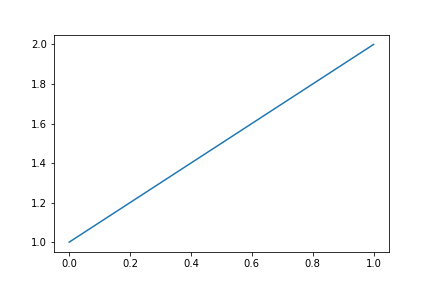

In [282]:
from io import BytesIO
figfile = BytesIO()
import base64

p = plt.plot(range(1,3))
plt.savefig(figfile, format='png')
plt.close()
figdata_png = base64.b64encode(figfile.getvalue())


img_html = '<img src="data:image/png;base64,%s&#10;">'%figdata_png.decode("utf-8") 

# print(img_html)


HTML("<h1>Hello</h1><hr/>"+img_html)

In [48]:
print(p)
sns.color_palette(p,13)

colorblind


[(0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
 (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),
 (0.8352941176470589, 0.3686274509803922, 0.0),
 (0.8, 0.47058823529411764, 0.7372549019607844),
 (0.792156862745098, 0.5686274509803921, 0.3803921568627451),
 (0.984313725490196, 0.6862745098039216, 0.8941176470588236),
 (0.5803921568627451, 0.5803921568627451, 0.5803921568627451),
 (0.9254901960784314, 0.8823529411764706, 0.2),
 (0.33725490196078434, 0.7058823529411765, 0.9137254901960784),
 (0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
 (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275)]

In [90]:
str(["'%s': %s<br>"%(p,palettes['speed'][p]) for p in palettes['speed']])

'["\'#993402\': 5<br>", "\'#fe0100\': 10<br>", "\'#fea000\': 20<br>", "\'#fbff00\': 30<br>", "\'#03ff00\': 40<br>", "\'#00b47b\': 50<br>", "\'#04cbd9\': 60<br>", "\'#1c65c9\': 80<br>", "\'#5006da\': 100<br>", "\'#555555\': 300<br>"]'

['Paired', 'magma', 'deep', 'muted', 'pastel', 'bright', 'dark', 'colorblind', 'rocket', 'rocket_r', 'flare', 'mako', 'crest', 'cubehelix', 'viridis', 'icefire', 'ch:s=-.2,r=.6', 'Spectral', 'coolwarm']


9,#555555,300
8,#5006da,100
7,#1c65c9,80
6,#04cbd9,60
5,#00b47b,50
4,#03ff00,40
3,#fbff00,30
2,#fea000,20
1,#fe0100,10
0,#993402,5
10,#999999,60

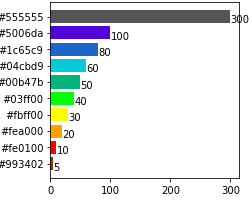
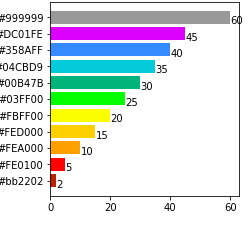
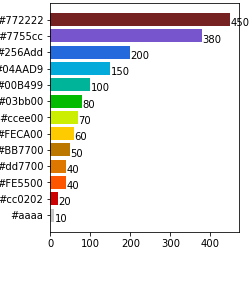
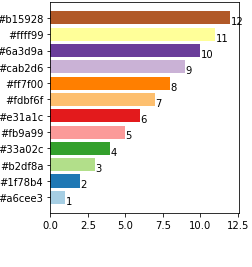
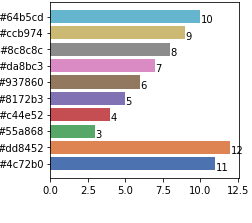
...
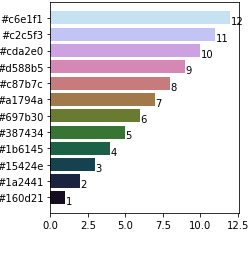
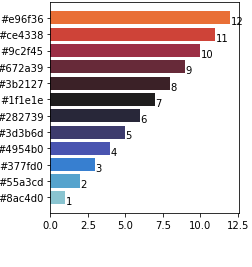
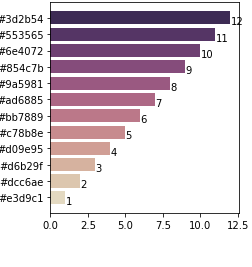
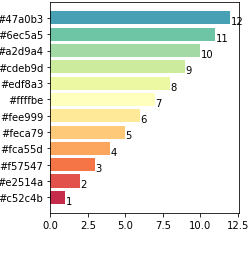
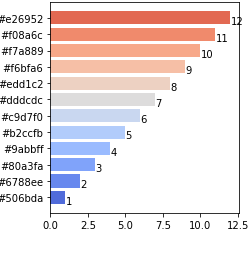

In [291]:


def colorise_palettes():
    import matplotlib.pyplot as plt
    
    img_html = ''
    pal_name = "Paired, magma, deep, muted, pastel, bright, dark, colorblind, rocket, rocket_r, flare, mako, crest, cubehelix, viridis, icefire, ch:s=-.2,r=.6, Spectral, coolwarm".split(", ")
    
    print(pal_name)
    
#     figfile = BytesIO()
    
    for p in pal_name:
        colors = [c for c in sns.color_palette(p,13).as_hex()]
        palettes[p] = dict(zip(colors,range(1,len(colors))))
    
    for k in palettes:
        figfile = BytesIO()
        
        plen = len(palettes[k])

        fig, ax = plt.subplots(figsize=(3.5, 0.31*plen))
        x,y = list(palettes[k].keys()),list(palettes[k].values())
        barlist = ax.barh(x, y, color = x )
        for i,b in enumerate(barlist):
#             print(y[i],b.xy[1],y[i])
            ax.text(y[i],b.xy[1],y[i])
        
        plt.subplots_adjust(left=0.2, right=0.95, top=0.99, bottom=0.2)
    
        fig.savefig(figfile, format='png')
        figdata_png = base64.b64encode(figfile.getvalue())


        plt.close()
        
        pl = "".join(["<tr ><td>%s</td><td>%s</td><td >%s</td></tr>"%(i,p,palettes[k][p]) for i,p in enumerate(palettes[k])][::-1])
        
        img_html = img_html + '''
                                    <div class='pall' style='width:350px; 
                                    height:300px; 
                                    line-height: 1.1; 
                                    border: red solid 0px; 
                                    background-position: top 52px left 95px;
                                    background-repeat: no-repeat;
                                    background-image:url(data:image/png;base64,%s&#10;)'><hr><b>%s</b><br><br><table class=tab>%s</table></div>
                                 '''%(figdata_png.decode("utf-8"),k,pl) 
        
    
#     print (img_html)
    display(HTML('''<style>.tab td {padding:1px 2px; border: red solid 0px; font-size:11px;  }</style><h1>Palettes</h1><a href ='https://seaborn.pydata.org/tutorial/color_palettes.html'>seaborn.pydata.org</a><div style='display: flex; flex-wrap:wrap;'>'''+img_html+"</div>"))
    
colorise_palettes()    

In [ ]:
'#a0da39',
'#73d056',
'#4ac16d',
'#2db27d',
'#1fa187',
'#21918c',
'#277f8e',
'#2e6e8e',
'#365c8d',
'#3f4788',
'#46327e',
'#481b6d',

In [256]:
# "%.1f"% (dist/(r['unixtime']-next_unixtime)*3600)
pd.options.mode.chained_assignment = None
df = dfr['track1'][::1]

# df['counted_speed'] = (df['unixtime'] - df['unixtime'].shift(1) )  # / df['unixtime']


df2 = df['lon'] - df['lon'].shift(1)
df['lon_delta'] = df2


df2 = df['lon'].rolling(10, min_periods=1).mean()

df['lon_rolling'] = df2

df['lon_rolling_delta'] = df['lon_rolling'] - df['lon_rolling'].shift(1)


# df['Rolling Close Average'] = df['Close*'].rolling(2).mean()

df[['lon_rolling_delta', 'lon_delta']].describe()

,lon_rolling_delta,lon_delta
count,3.074000e+03,3074.000000
mean,2.188647e-06,0.000002
std,4.663621e-05,0.000083
min,-3.747000e-04,-0.003762
25%,-3.277500e-05,-0.000030
50%,-1.000000e-07,0.000000
75%,3.890000e-05,0.000038
max,9.270000e-05,0.000612


In [378]:
[matplotlib.colors.to_hex(c, keep_alpha=True) for c in sns.diverging_palette(0, 255, center="dark",   sep=1, n=5)]

['#d53d69ff', '#803047ff', '#232426ff', '#354e7bff', '#4676caff']

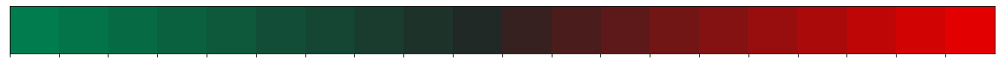

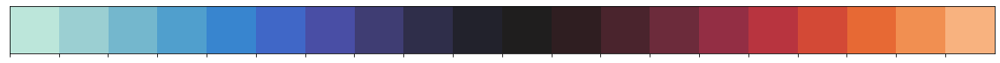

In [18]:
# '#%02x%02x%02x%02x' % 
import matplotlib

c = sns.diverging_palette(0, 255, l=65, center="dark",  n=20,  as_cmap=True)(.5)

# matplotlib.colors.to_hex(c, keep_alpha=True)
sns.palplot(sns.diverging_palette(150,10, s=120, l = 45, center="dark",sep=3, n=20))

c = [sns.color_palette("icefire", as_cmap=True)(i/20)  for i in range(0,20) ]

sns.palplot(c)

In [184]:
# 2022-05-05
import folium
from datetime import datetime
from datetime import timedelta
import matplotlib
tm()

# f = 'data/Zepp20220508174510.gpx'
# f = 'data/Zepp20220508064546.gpx'
# f = 'data/Zepp20220508211224.gpx'
# f = 'data/Zepp20220508211612.gpx'
f = 'data/Zepp20220509000808.gpx'





parse_gpx(f)



def draw_track(df, p=()):
    
    marker_colors = [c for c in sns.hls_palette(20, l=0.4, s=0.9).as_hex()]
    

    marker_colors = [matplotlib.colors.to_hex(c, keep_alpha=True) for c in sns.diverging_palette(150,10, s=120, l = 45, center="dark",sep=3, n=20)]
    
    
#     marker_colors = [matplotlib.colors.to_hex(sns.color_palette("icefire", as_cmap=True)(i/20), keep_alpha=True)  for i in range(0,20) ]
    
    [max_lat, max_lon] = df[['lat','lon']].max() 
    [min_lat, min_lon] = df[['lat','lon']].min() 
    
    marker_time  = start_time = df['unixtime'].min()
    
    total_points = df.shape[0]

    
    lat_start = df['lat'][0]
    lon_start = df['lon'][0]
    
    
    
    dist = 0
    
    map_area = [
        [max_lat, max_lon],
        [max_lat, min_lon],
        [min_lat, min_lon],
        [min_lat, max_lon],
        [max_lat, max_lon]
           ]

    center = [(max_lat+min_lat)/2, (max_lon+min_lon)/2]
    
    f = folium.Figure(width=1600, height=800)
    
    

    tiles='https://api.mapbox.com/v4/mapbox.streets/{z}/{x}/{y}.png?access_token=mytoken'
    tiles='http://gpxlab.ru/strava.php?z={z}&x={x}&y={y}'
    
    m = folium.Map(location=center, 
                   max_bounds=True,
#                    tiles=tiles,
#                    attr='Mapbox attribution'
                  ).add_to(f)
    
    
#     style = {'fillColor': '#00000000', 'color': '#00000000'}

#     folium.GeoJson(combined,
#                tooltip=folium.GeoJsonTooltip(fields=['LGA','MBRS'],
#                                              aliases=['Location','Members']),
#                style_function=lambda x: style).add_to(m)
    
    m.fit_bounds([map_area[0],map_area[2]])

    bounds=folium.PolyLine(locations=map_area ,weight=2,color='#ff880077')
    m.add_child(bounds)    
    m.add_child(folium.LatLngPopup())
    
#     m = folium.Map(
#    location=[45.523, -122.675],
#    zoom_start=2,
#    tiles='https://api.mapbox.com/v4/mapbox.streets/{z}/{x}/{y}.png?access_token=mytoken',
#    attr='Mapbox attribution')

#     print (tooltips)

#     for i,r in df.iterrows():
#         lat = r['lat_rolling_7']
#         lon = r['lon_rolling_7']
        
#         if (i>0):
            
#             c = [[lat,lon], [next_lat, next_lon]]
#             lap_dist = ll_distance(lat, lon, next_lat, next_lon)
            
#             dist += lap_dist
            
#             if (r['unixtime']-next_unixtime) == 0:
#                 counted_speed = 0
#             else: 
#                 counted_speed = "%.1f"% (lap_dist/(r['unixtime']-next_unixtime)*3600)
        
#             color = '#'+colorise(counted_speed, scooter_speed )+"55"
            
#             my_PolyLine=folium.PolyLine(locations=c,
#                                         weight=4,
#                                         color=color,
#                                         tooltip="%s \n [%s]  dist: %s speed: %s"% 
#                                                  (
#                                                   r['datetime'],
#                                                   r['speed'],
#                                                   "%.1f"%(lap_dist*1000), 
#                                                   counted_speed
#                                                  )
#                                        )
#             m.add_child(my_PolyLine)   
#         next_lat = lat
#         next_lon = lon
#         next_unixtime = r['unixtime']
        

    dist = 0    
    marker_dist = 0        
        
    
    for i,r in df.iterrows():
        lat = r['lat']
        lon = r['lon']
#         lat = r['lat_rolling_7']
#         lon = r['lon_rolling_7']        
        if (i>0):
            
            c = [[lat,lon], [next_lat, next_lon]]
            lap_dist = ll_distance(lat, lon, next_lat, next_lon)
            
            dist += lap_dist
            
            if (r['unixtime']-next_unixtime) == 0:
                counted_speed = 0
            else: 
                counted_speed = "%.1f"% (lap_dist/(r['unixtime']-next_unixtime)*3600)

            color = '#'+colorise(counted_speed, scooter_speed )+"55"
            my_PolyLine=folium.PolyLine(locations=c,
                                        weight=3,
                                        color=color,
                                        tooltip="%s \n [%s]  dist: %s speed: %s"% 
                                                 (
                                                  r['datetime'],
                                                  r['speed'],
                                                  "%.1f"%(lap_dist*1000), 
                                                  counted_speed
                                                 )
                                       )
            m.add_child(my_PolyLine)    
            
            
#             if(i%100 == 0):
#             if(r['unixtime'] - marker_time  >= 60):
            if(dist  >= marker_dist):

                marker_dist += 1
                marker_time += 60
                
                
                ll_next = ll_distance(lat_start, lon_start, next_lat, next_lon )
                ll = ll_distance(lat_start,lon_start, lat, lon )
                
                
                marker_color = "#33a02cff" if (ll > ll_next) else "#e31a1cff"
                
                
                marker_color = marker_colors[int(i / (total_points/20))]
                
                mapMarker =  folium.Marker(location=[lat, lon],
                      # Set icon to DivIcon to with conditional style formatting to reference the random temp value.
                      icon=folium.DivIcon(html=f"""<div style="width:40px; 
                                                  font-size:9px; 
                                                  color:%s;
                                                  margin:-7px 0 0 -15px;
                                                  line-height: 1.1;
                                                  padding:1px 2px;
                                                  text-align:center;   
                                                  border-radius: 7px;
                                                  border: 2px solid %s; 
                                                  background-color:#ffffff99;">%s<br>%.2f</div>"""% 
                                          (marker_color, marker_color, timedelta(0, r['unixtime'] - start_time), dist) 
                                         )
                     ).add_to(m)
            
        
        next_lat = lat
        next_lon = lon
        next_unixtime = r['unixtime']
        
    
    display(m)

params = (1000, 55.753145, 37.615845 , 0.3 , 1)

scooter_speed ={'#bb2202':3,
     '#FE0100':6,
     '#FEA000':9,
     '#FED000':12,
     '#FBFF00':15,
     '#03FF00':20,
     '#00B47B':25,
     '#04BBD9':30,
     '#358AFF':35,
     '#DC01dE':40,
     '#999999':10000
    }



df = dfr['track1'][::1]
df['lat_rolling_7'] = df['lat'].rolling(10, min_periods=1).mean()
df['lon_rolling_7'] = df['lon'].rolling(10, min_periods=1).mean()

draw_track(df)

*** Start at: 13:02:24 ₂₀₂₂₋₀₅₋₀₉  ************************************************************


<ipython-input-184-db27dbef369d>:222: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['lat_rolling_7'] = df['lat'].rolling(10, min_periods=1).mean()
<ipython-input-184-db27dbef369d>:223: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['lon_rolling_7'] = df['lon'].rolling(10, min_periods=1).mean()


In [53]:
list(df[['datetime','speed']].values)[0]

array(['2022-05-07 16:44:26', 0.0], dtype=object)

In [272]:
from datetime import datetime
datetime.fromtimestamp(1651931066).strftime("%Y-%m-%d %H:%M:%S")

'2022-05-07 16:44:26'

In [347]:
# 2022-05-05
import folium
tm()

df = dfr['parking_zone'][::1]

def swap(p):
    res = []
    for pp in p:
        res = res + [[pp[1],pp[0]]]
    return res


def draw_map(df, p=()):
    
    (r0,r1,r2,r3,r4) = p 

    
    zone = [
        [r1-r3,r2-r4],
        [r1+r3,r2-r4],
        [r1+r3,r2+r4],
        [r1-r3,r2+r4],
        [r1-r3,r2-r4]
           ]
    
    prices = list(df['price'])
    
    lng_lat = list(map(swap, [json.loads(x['geometry'])['coordinates'] for i,x in df.iterrows()]))

    center = lng_lat[0][0]
    center = [55.72,37.60]
    
    f = folium.Figure(width=1600, height=800)
    
    m = folium.Map(location=center, max_bounds=True).add_to(f)
    
    m.fit_bounds([[r1-r3,r2-r4],[r1+r3,r2+r4]])

    my_PolyLine=folium.PolyLine(locations=zone ,weight=3,color='#ff880077')
    m.add_child(my_PolyLine)    
    m.add_child(folium.LatLngPopup())

    [lat_max,lon_max,lat_min,lon_min]=[0,0,90,180] 
    
    for i,c in enumerate(lng_lat):
        price = list(df['price'])[i]

        lat_max = max(c[0][0],lat_max)
        lon_max = max(c[0][1],lon_max)

        lat_min = min(c[0][0],lat_min)
        lon_min = min(c[1][1],lon_min)

        
        
        my_PolyLine=folium.PolyLine(locations=c,
                                    weight=3,
                                    color='#'+colorise(price)+"cc",
                                   tooltip=prices[i], )
        m.add_child(my_PolyLine)    
    
    dlat = (lat_max-lat_min)/2 
    dlon = (lon_max-lon_min)/2 
    print ([lat_max,lon_max,lat_min,lon_min], (lat_max-dlat, lon_max-dlon, dlat ,dlon ) )

    
    display(m)

params = (1000, 55.753145, 37.615845 , 0.3 , 1)

draw_map(df[::1], params)
tm('>>>>')


*** Start at: 14:57:34 ₂₀₂₂₋₀₅₋₀₈  ************************************************************
[59.951672, 60.62204361, 51.645534, 30.338895] (55.798603, 45.480469305, 4.153069000000002, 15.141574304999999)


0:00:24.078 ₀╷₀₀╷₂₄.₀₇₈ >>>>


1652011078.1220913

In [9]:
import requests
import json
# import pandas as pd

tm()

params = (1000, 55.798603, 45.480469305, 4.3, 15.3)


url = "https://api.parkomatica.ru/zone/get-list?radius1=%s&latitude=%s&longitude=%s845&latitudeDelta=%s&longitudeDelta=%s"%params

# GET
r = requests.get(url)

df = dfr['parking_zone'] = pd.DataFrame(r.json()['data'])

df.to_pickle('parking_zone.pcl')

tm(df.shape[0])
df[:3]
if(df.shape[0]> 0 ):
    draw_map(df, params )

*** Start at: 11:53:51 ₂₀₂₂₋₀₅₋₀₈  ************************************************************
0:00:01.812 ₀╷₀₀╷₀₁.₈₁₂ 15100
[59.951672, 60.62204361, 51.645534, 30.338895] (55.798603, 45.480469305, 4.153069000000002, 15.141574304999999)


In [448]:

df = dfr['geo_cache'] 
df.iloc[0]['ll']

[55.69, 37.347]

In [513]:
dfr['geo_cache']

,building,house_number,road,city_district,city,state,ISO3166-2-lvl4,region,postcode,country,country_code,lat,lon,boundingbox
0,Технопарк Сколково,42 к1,Большой бульвар,Можайский район,Москва,Москва,RU-MOW,Центральный федеральный округ,143026,Россия,ru,55.69,37.347,"[55.6909659, 55.6964862, 37.3465382, 37.3482907]"


In [589]:
del dfr['geo_cache']

In [581]:
ll = [39.19166, 51.661509]
ll = [51.660625, 39.194632]

location = geolocator.reverse(ll)
print(location)

Cтарая афишная тумба, улица 9 Января, Чичеры, Ленинский район, Воронеж, городской округ Воронеж, Воронежская область, Центральный федеральный округ, 394018, Россия


In [601]:
def get_reverse(ll):

    location = geolocator.reverse(ll)
    print (ll,location.raw['address'])
    gc = location.raw['address'] 
    [gc['latitude'],gc['longitude']] = ll
    gc['boundingbox'] = [location.raw['boundingbox']]
    res = pd.DataFrame(gc)
#     print (gc)
#     disp (res)
    return res


cache_path = r'db/geo_cache.pcl'

def geo_cache(ll):
 
    if 'geo_cache' in dfr.keys():
#         print ("1. dfr true")
        df =  dfr['geo_cache']       
    else:
        try:
#             print ("2. file true")
            df = dfr['geo_cache'] = pd.read_pickle(cache_path)
        except:
            print ("3. no file")
            df = pd.DataFrame(columns={'longitude','latitude'})
            
    res = df[(df['latitude'] == ll[0]) & (df['longitude'] == ll[1])]
    if(res.shape[0] == 0):
        print ("4. add new")
        res = pd.DataFrame(get_reverse(ll))
        df = df.append(res)
        df.to_pickle(cache_path)           
        dfr['geo_cache'] = df        
    return res
    
geo_cache([55.697,37.347]) 

,longitude,latitude,city_district,village,state,ISO3166-2-lvl4,region,postcode,country,country_code,...,suburb,highway,shop,amenity,building,residential,ISO3166-2-lvl15,municipality,industrial,town
0,37.347,55.697,Можайский район,Инновационный центр «Сколково»,Москва,RU-MOW,Центральный федеральный округ,143026,Россия,ru,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [596]:
df = pd.read_pickle(cache_path)
df.count()

longitude          150
latitude           150
city_district       79
village              1
state              150
ISO3166-2-lvl4     150
region             149
postcode           149
country            150
country_code       150
boundingbox        150
county              31
house_number       101
road               147
neighbourhood       20
city               147
tourism              3
craft                2
quarter              7
suburb             100
highway              4
shop                 2
amenity             27
building             6
residential          1
ISO3166-2-lvl15     14
municipality         2
industrial           1
town                 1
dtype: int64

In [597]:
ii(dfr,1)

,name,rows,cols,memory,keys
0,df = dfr['parking_zone'],15100,7,"845,728","['id', 'number', 'geometry', 'price_description', 'price', 'weekends', 'periods']"
1,df = dfr['georeverse_parkig'],16,18,"2,432","['house_number', 'road', 'neighbourhood', 'city_district', 'city', 'county', 'state', 'ISO3166-2-lvl4', 'region', 'postcode', 'country', 'country_code', 'building', 'suburb', 'residential', 'amenity', 'quarter', 'ISO3166-2-lvl15']"
2,df = dfr['ЦКАД_from_kml'],1,7,177,"['WKT', 'название', 'описание', 'name', 'showOnMap', 'strokeWidth', 'strokeOpacity']"
3,df = dfr['geo_cache'],150,29,"36,000","['longitude', 'latitude', 'city_district', 'village', 'state', 'ISO3166-2-lvl4', 'region', 'postcode', 'country', 'country_code', 'boundingbox', 'county', 'house_number', 'road', 'neighbourhood', 'city', 'tourism', 'craft', 'quarter', 'suburb', 'highway', 'shop', 'amenity', 'building', 'residential', 'ISO3166-2-lvl15', 'municipality', 'industrial', 'town']"


In [423]:
location = geolocator.reverse([55.69,37.347])

location.raw

{'place_id': 191873293,
 'licence': 'Data © OpenStreetMap contributors, ODbL 1.0. https://osm.org/copyright',
 'osm_type': 'way',
 'osm_id': 382743663,
 'lat': '55.693769849999995',
 'lon': '37.34740556441982',
 'display_name': 'Технопарк Сколково, 42 к1, Большой бульвар, Можайский район, Москва, Центральный федеральный округ, 143026, Россия',
 'address': {'building': 'Технопарк Сколково',
  'house_number': '42 к1',
  'road': 'Большой бульвар',
  'city_district': 'Можайский район',
  'city': 'Москва',
  'state': 'Москва',
  'ISO3166-2-lvl4': 'RU-MOW',
  'region': 'Центральный федеральный округ',
  'postcode': '143026',
  'country': 'Россия',
  'country_code': 'ru'},
 'boundingbox': ['55.6909659', '55.6964862', '37.3465382', '37.3482907']}

In [612]:
dfr['parking_zone'].count()

id                   15100
number               15100
geometry             15100
price_description    13765
price                15100
weekends             15100
periods              15100
dtype: int64

In [629]:
from geopy.geocoders import Nominatim
tm()
geolocator = Nominatim(user_agent="jupyter")

df = dfr['parking_zone'][::3000]

lap = 0

georeverse = pd.DataFrame()

for i,r in df.iterrows():
    c = json.loads(r['geometry'])['coordinates'][0]
    
    gc = geo_cache([c[1],c[0]])
    
    jrow = {
        'city': gc['city'][0],
        'region': gc['region'][0],
        'road':gc['road'][0],
        'geometry':json.loads(r['geometry'])['coordinates'],
        'price': r['price'],
        'latitude': c[0],
        'longitude': c[1],
            
           }
    
#     disp(gc[['city','region']]) 
#     print(r[['price']])
    
    georeverse = georeverse.append(jrow, ignore_index=True)  


    if lap%10 == 0: 
        tm([i,gc['city']])
    lap += 1
#     print (location.raw)

    
dfr['georeverse_parkig'] = df = pd.DataFrame(georeverse)

tm("\n".join(["Count",str(df.count())]))
df[:3]

*** Start at: 21:14:34 ₂₀₂₂₋₀₅₋₀₅  ************************************************************
0:00:00.007 ₀╷₀₀╷₀₀.₀₀₇ [0, 0    Нижний Новгород
Name: city, dtype: object]
0:00:00.018 ₀╷₀₀╷₀₀.₀₂₆ Count
city         6
region       6
road         6
geometry     6
price        6
latitude     6
longitude    6
dtype: int64


,city,region,road,geometry,price,latitude,longitude
0,Нижний Новгород,Приволжский федеральный округ,Нижне-Волжская набережная,"[[44.005571008, 56.331992365], [44.000903964, 56.331689023]]",60.0,44.005571,56.331992
1,Пермь,Приволжский федеральный округ,улица Максима Горького,"[[56.251537, 58.016116], [56.251415, 58.016241]]",20.0,56.251537,58.016116
2,Москва,Центральный федеральный округ,Зоологическая улица,"[[37.582335, 55.764214], [37.58249, 55.764289], [37.582807, 55.764446]]",380.0,37.582335,55.764214


In [ ]:
place_id	licence	osm_type	osm_id	lat	lon	display_name	address	boundingbox
0	285140293	Data © OpenStreetMap contributors, ODbL 1.0. https://osm.org/copyright	relation	2860612	56.331676900000005	44.004868200000004	1Б, Нижне-Волжская набережная, Кремль, Нижегородский район, Нижний Новгород, городской округ Нижний Новгород, Нижегородская область, Приволжский федеральный округ, 603082, Россия	{'house_number': '1Б', 'road': 'Нижне-Волжская набережная', 'neighbourhood': 'Кремль', 'city_district': 'Нижегородский район', 'city': 'Нижний Новгород', 'county': 'городской округ Нижний Новгород', 'state': 'Нижегородская область', 'ISO3166-2-lvl4': 'RU-NIZ', 'region': 'Приволжский федеральный округ', 'postcode': '603082', 'country': 'Россия', 'country_code': 'ru'}	[56.3315216, 56.3318322, 44.0038091, 44.0059273]

In [ ]:
from geopy.geocoders import GoogleV3
geolocator = GoogleV3(api_key='Your_API_Key')
location = geolocator.reverse("52.509669, 13.376294")
print(location.address)

In [378]:
dfr = {}

In [379]:
# 2022-04-22 read_parking
import json
data = []
def load_park_zones():
    fname = r'C:\Users\S.Savinskiy\Downloads\response_1650638252002.json'
    fname = r'C:\Users\S.Savinskiy\Downloads\response_2022-05-04.json'
    
    with open(fname,'rb') as f:
        data = json.loads(f.read())
    
    parkings = data['data']   #[:2]
    
#     print (parkings)
    
#     df_nested_list = pd.json_normalize(parkings, record_path =['coordinates'])
    
    return pd.DataFrame(parkings)

dfr['parking_zone'] = df  = load_park_zones()


tm(['>>>>',df.info(),
dfr['parking_zone'].count()
   ])
disp(df[:3])
df.groupby(['price']).count().reset_index()['price'].to_list()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15100 entries, 0 to 15099
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   id                 15100 non-null  int64 
 1   number             15100 non-null  object
 2   geometry           15100 non-null  object
 3   price_description  13765 non-null  object
 4   price              15100 non-null  int64 
 5   weekends           15100 non-null  object
 6   periods            15100 non-null  object
dtypes: int64(2), object(5)
memory usage: 825.9+ KB
0:20:36.995 ₀╷₂₀╷₅₃.₅₅₄ ['>>>>', None, id                   15100
number               15100
geometry             15100
price_description    13765
price                15100
weekends             15100
periods              15100
dtype: int64]


,id,number,geometry,price_description,price,weekends,periods
0,32784,057,"{""type"":""LineString"",""coordinates"":[[44.005571008,56.331992365],[44.000903964,56.331689023]]}",60руб/час с 08:00 до 20:00,60,[],[]
1,32785,001,"{""type"":""LineString"",""coordinates"":[[43.98706913,56.328997505],[43.987573385,56.32839672]]}",60руб/час с 08:00 до 20:00,60,[],[]
2,32786,013,"{""type"":""LineString"",""coordinates"":[[44.017179608,56.316502508],[44.017724097,56.316670603]]}",60руб/час с 08:00 до 20:00,60,[],[]


[0, 1, 20, 30, 40, 50, 60, 70, 80, 100, 150, 200, 380, 450]

*** Start at: 13:49:11 ₂₀₂₂₋₀₄₋₂₅  ************************************************************


<BarContainer object of 20 artists>

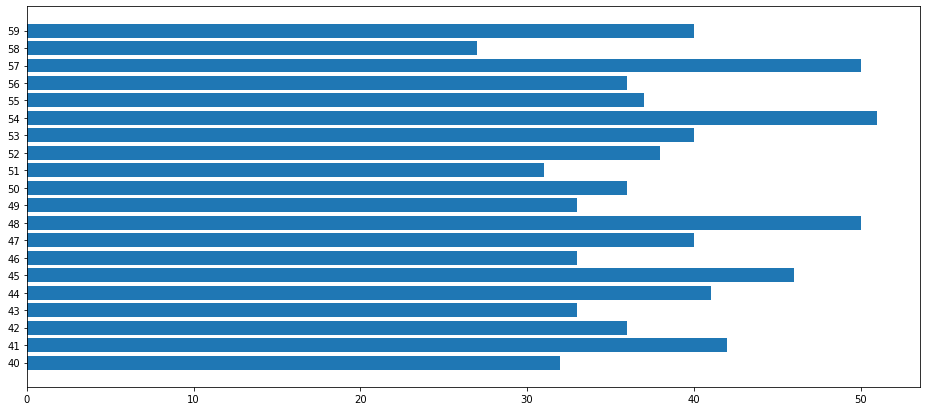

In [366]:


tm()
from datetime import datetime
df = dfr['bmo_last_devide_id'] = pd.read_csv(r'C:\Users\S.Savinskiy\Downloads\bmo_last.csv')

# ts =  df.sort_values(['unixtime'], ascending=False)
# print (ts)
df['iso_time'] = df['unixtime'].apply(lambda x: str(datetime.utcfromtimestamp(x).strftime('%Y-%m-%d %H:%M:%S')))

df = df[df['unixtime'] > (df['unixtime'].max() - 3600*24*300 )   ]

dfg = df.groupby(df['iso_time'].str[-2:19])['device_id'].count().reset_index()

dfg = dfg.sort_values(['iso_time'])[-20:]

# print(dfg.shape[0],dfg.info())

plt.figure(figsize=(16,7))
plt.barh(dfg['iso_time'],dfg['device_id'])

In [95]:
df = dfr['track'] = pd.read_csv(r'C:\Users\S.Savinskiy\Downloads\89701010068337419768 (1).csv')
bins = [-1,1e-3,1e-2,1e-1,1]

d = 'speed'

cuts = pd.cut(df[d],10).apply(lambda x: pd.Interval(left=int(round(x.left)), right=int(round(x.right))))

g_step=10
cuts = pd.cut(df[d],range(0,df[d].max()+g_step*2,g_step))

dfg = df.groupby(cuts ).count().rename(columns={d:'bar'}).reset_index()
# disp(dfg)


x = dfg[d].astype(str)
y = dfg['bar']

plt.figure(figsize=(10,4))
barlist = plt.barh(x, y)
plt.bar_label(barlist)

for i,sp in enumerate(dfg[d]):
    barlist[i].set_color(colorise(sp.left,palettes['speed']))

plt.show()
plt.figure(figsize=(11,11))
plt.scatter(df['latitude'], df['longitude'], c=df['speed'].apply(lambda x: colorise(x)))

plt.show()

FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\S.Savinskiy\\Downloads\\89701010068337419768 (1).csv'

In [65]:
pd.DataFrame(df['periods'][0])['price'].max()

38000

In [210]:
ii(dfr,1)

,name,rows,cols,memory,keys
0,df = dfr['track'],1238,6,"59,552","['to_timestamp', 'latitude', 'longitude', 'speed', 'fuel', 'speed_engine']"
1,df = dfr['track2'],1238,6,"59,552","['to_timestamp', 'latitude', 'longitude', 'speed', 'fuel', 'speed_engine']"


In [34]:
# 2022-04-16 https://developers.google.com/kml/documentation/kmlreference
# https://kml4earth.appspot.com/icons.html
# https://icons8.com/icon/set/atransport/color
# hotel - https://img.icons8.com/office/32/hotel-information.png
# gas station https://img.icons8.com/color/32/gas-station.png

tm()
import simplekml


def Draw(fname,routes,points):
    kml = simplekml.Kml()
    for df_point in points:
        for i,row in df_point['points'].iterrows():
            pt2 = kml.newpoint(name= row['name'], coords=[(row['Longitude'],row['Latitude'])])
            pt2.style.iconstyle.icon.href = df_point['icon']
#             set color of icon to be cyan (RGB=#00ffff)
            pt2.style.iconstyle.color ='44ff8800' # aabbggrr
    
                                          
    for df_route in routes:                                      
        route = [tuple(x) for x in df_route['route'][['Longitude','Latitude']].values]

        lin = kml.newlinestring(name=df_route["name"])
        lin.style.linestyle.color = '228800ff'  # Red
        lin.style.linestyle.width= 5  # 10 pixels
        lin.coords = route
    kml.save(fname)    



*** Start at: 13:25:26 ₂₀₂₂₋₀₄₋₂₂  ************************************************************


In [9]:
df[:5]

""


In [96]:
tm()

coll  = db.poi_gson
coll.drop()

ins = []

els = db.poi.find().limit(40000)

tm('1. get els')

for element in els: 
    ins = ins + [{
        "_id": element["_id"],
        "name": element["name"],
        "category": element["category"],
        "subcategory": element["subcategory"],
        "loc": {
            "type": "Point",
            "coordinates": [element["lng"], element["lat"]]
        
        }}]

tm(['1. list ready',len(str(ins))])

coll.insert_many(ins)

tm(['>>>>>'])

*** Start at: 16:52:43 ₂₀₂₂₋₀₄₋₁₉  ************************************************************
0:00:00.024 ₀╷₀₀╷₀₀.₀₂₄ 1. get els
0:00:14.715 ₀╷₀₀╷₁₄.₇₃₉ ['1. list ready', 7675403]
0:00:00.924 ₀╷₀₀╷₁₅.₆₆₄ ['>>>>>']


In [107]:
ii(dfr,1)

,name,rows,cols,memory,keys
0,df = dfr['route_574'],13536,6,"758,016","['lat', 'lng', 'unixtime', 'isotime', 'fuel', 'speed']"
1,df = dfr['osm poi'],1166350,6,"55,984,928","['id', 'name', 'category', 'subcategory', 'lng', 'lat']"
2,df = dfr['poi_accomodation'],34,4,"1,216","['Latitude', 'Longitude', 'name', 'subcategory']"


In [747]:
#2022-04-05 расчет дистанции 

import math


def geo_shift(p, dist):
    
    cos_d = math.cos( p[1]  * math.pi/180 )

    lat_delt = dist / 110.574 / 1000
    lng_delt = dist / 111.320 / 1000 /cos_d


    return [lng_delt, 
            lat_delt, 
            p[0] + lng_delt, 
            p[1] + lat_delt,
            p[0] - lng_delt, 
            p[1] - lat_delt
           ]



def f_distance(lat1, lon1, lat2, lon2,unit = "K") :
    
    if ((lat1 == lat2) & (lon1 == lon2)):
        return 0

    else:
        radlat1 = math.pi * lat1/180;
        radlat2 = math.pi * lat2/180;
        theta = lon1-lon2;
        radtheta = math.pi * theta/180;
        dist = math.sin(radlat1) * math.sin(radlat2) + math.cos(radlat1) * math.cos(radlat2) * math.cos(radtheta);
        if (dist > 1) :
            dist = 1;
        
        dist = math.acos(dist);
        dist = dist * 180/math.pi;
        dist = dist * 60 * 1.1515;
        if unit=="K": dist = dist * 1.609344 
        if unit=="N": dist = dist * 0.8684 
        return dist;

gs = geo_shift([37.40, 55.7], 3000)
print ( '%s,%s\n%s,%s' % tuple(gs[2:]))
    
f_distance(55.1,37.20, 55.2,37.3,"K")

37.44782269657372,55.727131151988715
37.352177303426274,55.67286884801129


12.806276228290576

In [487]:
# 2022-04-08 POI to local PG

def db_sql(sqls):
    conn = psycopg2.connect(connection_string)

    conn.set_isolation_level(ISOLATION_LEVEL_AUTOCOMMIT);

    print("Database opened successfully")
    curs = conn.cursor();

     #drop_database, create_database, 


    for sql in sqls:
        try:
            curs.execute(sql)
            # NB : you won't get an IntegrityError when reading
        except Exception as ex:
            print(ex, sql)
            
    tm('init db')


    conn.close()
    
sql_database_info =  '''select t1.datname AS db_name,  
                    pg_size_pretty(pg_database_size(t1.datname)) as db_size
                    from pg_database t1
                    order by pg_database_size(t1.datname) desc;'''


create_poi_table = '''DROP TABLE IF EXISTS POI; CREATE TABLE POI (
    ID  varchar(255) PRIMARY KEY,
    CATEGORY varchar(32),
    SUBCATEGORY varchar(32),
    MAME varchar(128),
    LON varchar(32),
    LAT varchar(32),
    LON_F float,
    LAT_F float,
    LON_I int,
    LAT_I int
);'''

create_route_table = '''DROP TABLE IF EXISTS ROUTE; CREATE TABLE ROUTE (
    ID  varchar(255) PRIMARY KEY,
    ROUTE_NAME varchar(255),
    UNIXTIME varchar(255),
    LON varchar(255),
    LAT varchar(255),
    iso_time varchar(64),
    FUEL float,
    SPEED int
);'''    
    

sqls = [create_route_table]    

tm()
db_sql(sqls)
tm('>>>')

*** Start at: 10:56:26 ₂₀₂₂₋₀₄₋₁₂  ************************************************************
0:00:00.000 ₀╷₀₀╷₀₀.₀₀₀ >>>


In [ ]:

# 2022-04-08  read_csv to_sql from file by chunk *******************


from sqlalchemy import create_engine

cols = ['Unnamed: 0', 'ID', 'NAME', 'CATEGORY', 'SUBCATEGORY', 'LON', 'LAT',
       'SRID', 'WKT', 'INTERNATIONAL_NAME', 'STREET', 'WIKIPEDIA', 'PHONE',
       'CITY', 'EMAIL', 'ALTERNATIVE_NAME', 'OPENING_HOURS', 'DESCRIPTION',
       'WEBSITE', 'LAST_UPDATE', 'OPERATOR', 'POSTCODE', 'COUNTRY', 'FAX',
       'IMAGE', 'HOUSENUMBER', 'OTHER_TAGS']

tm()

fname = r'C:\_dev\jupyter_notebook\jnlab\prj\poi\2021-12-18\russia_poi\russia_poi.csv'

columns = { 'ID':'id',
            'NAME':'name',
            'CATEGORY':'category',
            'SUBCATEGORY':'subcategory',
            'LON':'lng',
            'LAT':'lat'
          }

# usecols=columns, 

df = pd.read_csv(fname, sep='|', usecols=columns.keys(),  nrows = 10000000 )

dfr['osm poi'] = df = df.rename(columns=columns)

tm(['1. read poi', df.count()])


engine = create_engine()

dflap = pd.DataFrame(columns=['chunk','t','lap'])


tm('2. start insert')

for lap in range(0,1):
    dflist = []
    
    for chs in range(10,11):
        start_lap = time.time()
        df.to_sql("poi", engine, if_exists='replace', chunksize = 2**chs)
        tm(['3. end insert', chs])
        delt_lap = time.time() - start_lap 
        dflap.loc[len(dflap)] = [chs,delt_lap,lap]
    
    df_out = (dflap.pivot_table(index=['chunk'], columns='lap', values='t')
                .rename_axis(columns=None)
             ).reset_index()


    df_out.loc[:, df_out.columns != 'chunk'].plot(figsize=(10,7))
    plt.show()

tm('3. insert finished')


ix_poi_lat = '''CREATE INDEX ix_poi_lat
    ON public.poi USING btree
    (lat ASC NULLS LAST)
    TABLESPACE pg_default;'''

ix_poi_lng = '''CREATE INDEX ix_poi_lng
    ON public.poi USING btree
    (lng ASC NULLS LAST)
    TABLESPACE pg_default;'''

db_sql([ix_poi_lat,ix_poi_lng])
    
    
tm('>>>')



*** Start at: 23:06:19 ₂₀₂₂₋₀₄₋₁₄  ************************************************************
0:00:09.585 ₀╷₀₀╷₀₉.₅₈₅ ['1. read poi', id             1166350
name           1166350
category       1166350
subcategory    1166350
lng            1166350
lat            1166350
dtype: int64]
0:00:00.002 ₀╷₀₀╷₀₉.₅₈₇ 2. start insert
